# Human beta cell velocity across donors

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
sc.settings.verbosity = 3
sc.logging.print_header()

scanpy==1.6.0 anndata==0.7.8 umap==0.4.5 numpy==1.21.2 scipy==1.5.4 pandas==1.3.5 scikit-learn==0.22 statsmodels==0.13.2 python-igraph==0.8.0 louvain==0.7.0 leidenalg==0.7.0


In [3]:
sc.set_figure_params(frameon=False, dpi_save=300, color_map='Reds')

In [13]:
adata_beta = sc.read('./data/adata_human_beta.h5ad')
adata_beta.obs_names = [x.replace('_1', '') for x in adata_beta.obs_names]

In [23]:
adata_beta.obs.donor.value_counts()

74    3827
63    2440
61    2196
22    1975
24    1485
Name: donor, dtype: int64

In [14]:
# load raw data
adata_raw = sc.read('../../pancreatic-endocrine-cells-cross-species/human_islets/data/GEO/human_raw.h5ad')

## Beta cell donor 74

In [15]:
adata_74_velo_beta = adata_raw[adata_raw.obs['sample']=='74'].copy()

In [16]:
adata_74_velo_beta = adata_74_velo_beta[[ix for ix in adata_beta.obs_names if ix in adata_74_velo_beta.obs_names]].copy()

In [28]:
# load loom file
adata_74_loom = sc.read_loom('./data/velocity/possorted_genome_bam_CUAJK.loom')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [29]:
adata_74_loom.obs_names

Index(['possorted_genome_bam_CUAJK:AAACGGGCATTCACTTx',
       'possorted_genome_bam_CUAJK:AAAGCAAGTCACTGGCx',
       'possorted_genome_bam_CUAJK:AAAGATGAGTACGTTCx',
       'possorted_genome_bam_CUAJK:AAACCTGGTTCCACAAx',
       'possorted_genome_bam_CUAJK:AAAGATGCAATCTGCAx',
       'possorted_genome_bam_CUAJK:AAACGGGAGTGTACTCx',
       'possorted_genome_bam_CUAJK:AAAGCAAGTGGTTTCAx',
       'possorted_genome_bam_CUAJK:AAACGGGGTCACTTCCx',
       'possorted_genome_bam_CUAJK:AAAGTAGTCCGTAGTAx',
       'possorted_genome_bam_CUAJK:AAAGATGTCAAGGCTTx',
       ...
       'possorted_genome_bam_CUAJK:TTTGTCAAGTGGTAATx',
       'possorted_genome_bam_CUAJK:TTTGTCAAGTTAACGAx',
       'possorted_genome_bam_CUAJK:TTTGTCACATATGGTCx',
       'possorted_genome_bam_CUAJK:TTTGTCATCTGCCCTAx',
       'possorted_genome_bam_CUAJK:TTTGTCACAGGCAGTAx',
       'possorted_genome_bam_CUAJK:TTTGTCAGTGCGAAACx',
       'possorted_genome_bam_CUAJK:TTTGTCAGTAAGGATTx',
       'possorted_genome_bam_CUAJK:TTTGTCACACGAGAGTx',

In [37]:
adata_74_velo_beta.obs_names

Index(['AAACCTGAGTATTGGA-74', 'AAACCTGGTTTGACTG-74', 'AAACCTGTCAGCTCTC-74',
       'AAACCTGTCGCTTAGA-74', 'AAACCTGTCGGTTAAC-74', 'AAACGGGAGCTAAACA-74',
       'AAACGGGAGTGTACTC-74', 'AAACGGGCAAACGCGA-74', 'AAACGGGCATTAGCCA-74',
       'AAACGGGGTCACTTCC-74',
       ...
       'TTTGTCAAGTACGCGA-74', 'TTTGTCAAGTGCAAGC-74', 'TTTGTCAAGTTAACGA-74',
       'TTTGTCAGTAAGGATT-74', 'TTTGTCAGTAGGACAC-74', 'TTTGTCAGTCAGCTAT-74',
       'TTTGTCAGTCCGAATT-74', 'TTTGTCAGTCGGGTCT-74', 'TTTGTCATCCAGTAGT-74',
       'TTTGTCATCCCACTTG-74'],
      dtype='object', length=3827)

In [38]:
# adapt obs_names to match
adata_74_loom.obs_names = [x[27:-1] +'-74' for x in adata_74_loom.obs_names]

In [39]:
# filter and sort velocity/loom adata
adata_74_loom = adata_74_loom[[x for x in adata_74_velo_beta.obs_names if x in adata_74_loom.obs_names]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [40]:
adata_74_loom

AnnData object with n_obs × n_vars = 3827 × 32738
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [41]:
adata_74_loom.var_names_make_unique()

In [42]:
adata_74_loom.var_names

Index(['FAM138A', 'RP11-34P13.7', 'RP11-34P13.8', 'AL627309.1',
       'RP11-34P13.14', 'AP006222.2', 'RP4-669L17.2', 'RP5-857K21.1',
       'RP5-857K21.3', 'RP5-857K21.4',
       ...
       'BPY2', 'DAZ2', 'AC016752.1', 'TTTY17B', 'TTTY4B', 'BPY2B', 'DAZ4',
       'CSPG4P1Y', 'CDY1', 'TTTY3'],
      dtype='object', name='Gene', length=32738)

In [43]:
adata_74_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [44]:
adata_74_loom = adata_74_loom[:,[x for x in adata_74_velo_beta.var_names if x in adata_74_loom.var_names]].copy()

In [45]:
# add unspliced/spliced count information to raw data
adata_74_velo_beta.layers['matrix'] = adata_74_loom.layers['matrix']
adata_74_velo_beta.layers['ambiguous'] = adata_74_loom.layers['ambiguous']
adata_74_velo_beta.layers['spliced'] = adata_74_loom.layers['spliced']
adata_74_velo_beta.layers['unspliced'] = adata_74_loom.layers['unspliced']
del adata_74_loom

This requires to run velocyto to extract information on splices/unspliced reads

In [46]:
# subset to donor 74 to get meta data
adata_74_proc = adata_beta[np.isin(adata_beta.obs['donor'], ['74'])].copy()

In [48]:
# # adapt obs_names and ordering
# adata_74_proc.obs_names = [x[0:16] for x in adata_74_proc.obs_names]
# adata_74_velo_beta = adata_74_velo_beta[[x for x in adata_74_proc.obs_names if x in adata_74_velo_beta.obs_names]].copy()

In [47]:
# add metadata
adata_74_velo_beta.obs = adata_74_proc.obs.loc[adata_74_velo_beta.obs_names].copy()

In [49]:
# normalize raw data using exclude_highly_expressed
sc.pp.normalize_total(adata_74_velo_beta, exclude_highly_expressed=True)
sc.pp.log1p(adata_74_velo_beta)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['GCG', 'SST', 'HSPA5', 'INS', 'FTH1', 'MALAT1', 'IAPP', 'PPY', 'TTR', 'FTL']
    finished (0:00:00)


In [50]:
# exlude mtDNA deficient subtype
adata_74_proc = adata_74_proc[np.invert(adata_74_proc.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [51]:
# compute manifold
sc.pp.pca(adata_74_proc)
sc.pp.neighbors(adata_74_proc)
sc.tl.umap(adata_74_proc)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


In [52]:
len(set(adata_74_proc.obs_names).intersection(adata_74_velo_beta.obs_names))

3644

In [53]:
adata_74_velo_beta = adata_74_velo_beta[np.invert(adata_74_velo_beta.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [54]:
adata_74_velo_beta.obsm['X_umap'] = adata_74_proc.obsm['X_umap']

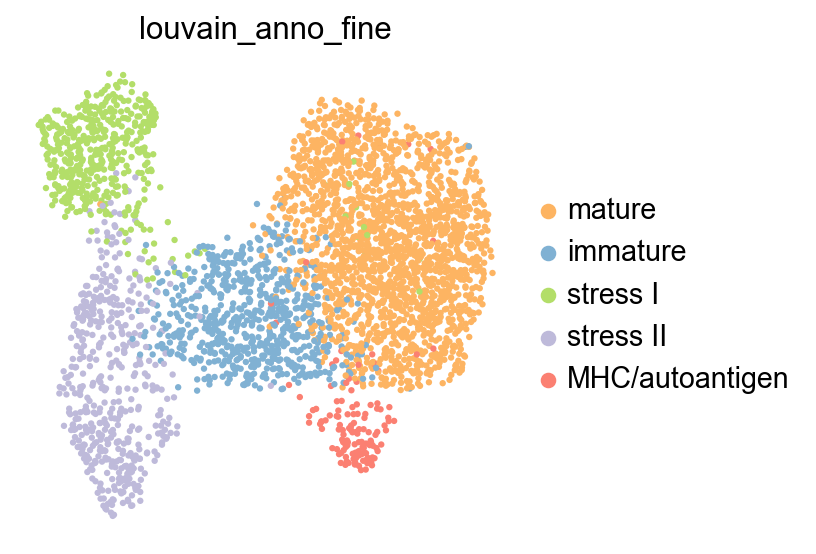

In [57]:
sc.pl.umap(adata_74_velo_beta,color='louvain_anno_fine')

In [58]:
adata_74_velo_beta.obs['louvain_anno_fine'].value_counts()

mature             1869
immature            693
stress II           478
stress I            473
MHC/autoantigen     131
Name: louvain_anno_fine, dtype: int64

In [668]:
scv.pp.filter_and_normalize(adata_74_velo_beta, min_shared_counts=10, n_top_genes=4000, min_cells_u=10)

Filtered out 17325 genes that are detected in less than 10 cells (unspliced).
Filtered out 6288 genes that are detected 10 counts (shared).
Normalized count data: spliced, unspliced.
Exctracted 4000 highly variable genes.


In [669]:
scv.pp.moments(adata_74_velo_beta)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:01)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [672]:
scv.tl.velocity(adata_74_velo_beta)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [675]:
%%time
scv.tl.recover_dynamics(adata_74_velo_beta)

recovering dynamics
    finished (0:05:15) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
CPU times: user 5min 12s, sys: 1.06 s, total: 5min 13s
Wall time: 5min 15s


In [735]:
top_genes = adata_74_velo_beta.var['fit_likelihood'].sort_values(ascending=False)[adata_74_velo_beta.var['fit_likelihood'].sort_values(ascending=False)>0.1].index
scv.tl.differential_kinetic_test(adata_74_velo_beta, var_names=top_genes, groupby='louvain_anno_fine')

testing for differential kinetics
    finished (0:01:00) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [738]:
adata_74_velo_beta = adata_74_velo_beta_2.copy()

In [624]:
len(top_genes)

793

In [747]:
adata_74_velo_beta.uns['louvain_anno_fine_colors'] = adata_beta.uns['louvain_anno_fine_colors'][0:5]

In [739]:
scv.tl.velocity(adata_74_velo_beta, diff_kinetics=False)
scv.tl.velocity_graph(adata_74_velo_beta, gene_subset=top_genes)

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


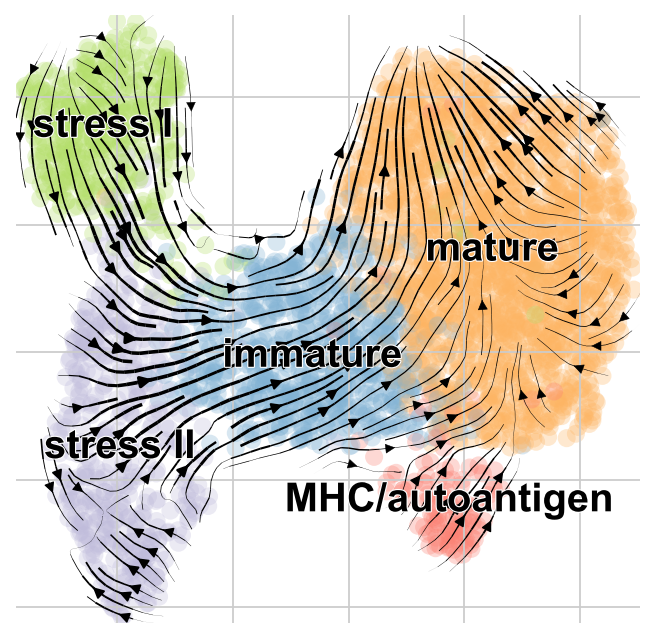

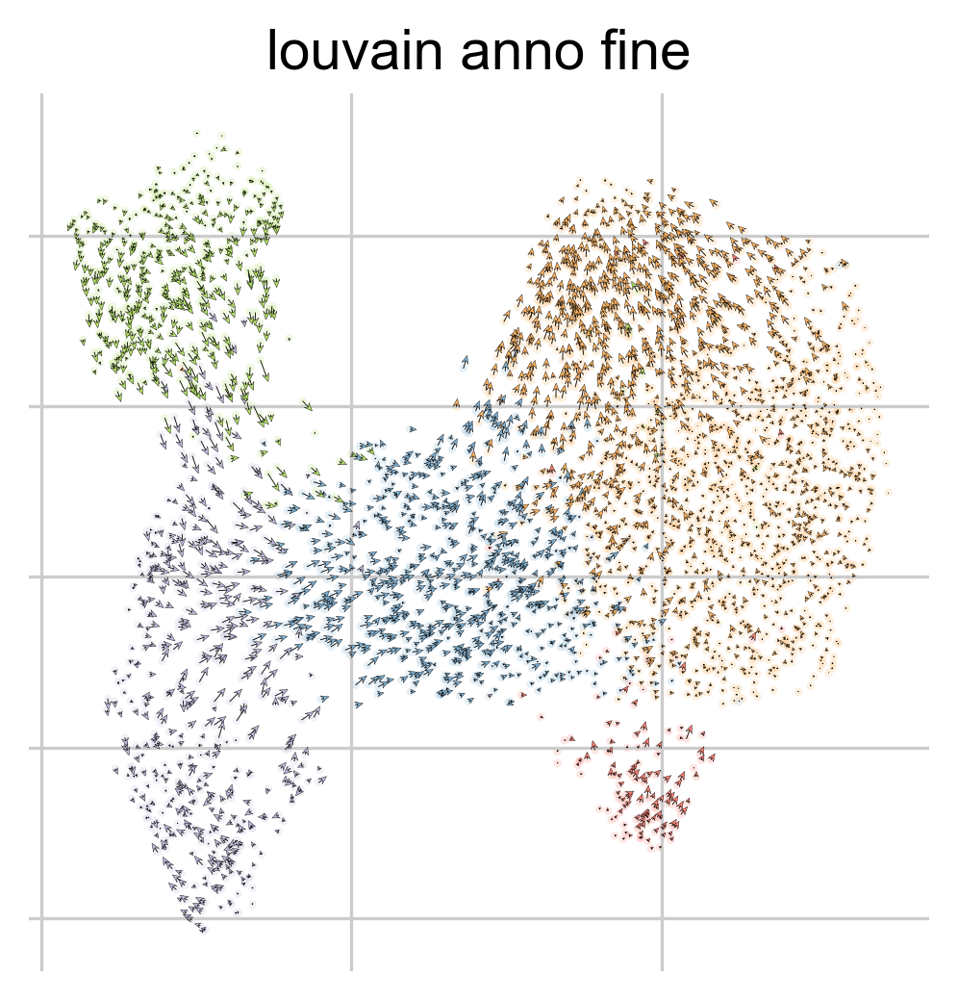

In [61]:
scv.pl.velocity_embedding_stream(adata_74_velo_beta, basis='umap',color='louvain_anno_fine',figsize=(5,5), legend_fontsize=18, title='')
scv.pl.velocity_embedding(adata_74_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='louvain_anno_fine')

#### differential velocyto expression test

In [38]:
scv.tl.rank_velocity_genes(adata_74_velo_beta, groupby='louvain_anno_fine', n_genes=1800, min_likelihood=0.1)
df = scv.DataFrame(adata_74_velo_beta.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,mature,immature,stress I,stress II,MHC/autoantigen
0,ABCC8,PAPSS2,PDE4C,NAPA,FBXW7
1,CACNA1A,ANXA11,MANF,PAWR,ASAP1
2,LRP10,ASXL1,ZNF556,NDRG4,C9orf16
3,CAPN13,LIMCH1,GINS3,SETX,SPC25
4,DPP6,EXPH5,VPS37B,MAPK6,DLG1
5,INSIG1,PAK3,MACROD1,SPTLC2,MIR7-3HG
6,AGPAT2,WNT4,POU2F2,ACTN4,RHOBTB3
7,SEMA4B,HNF4A,SLC16A10,EML5,ELMO1
8,RIN2,KCNJ6,CELF5,PLEKHH2,ZNF385D
9,MGST2,LPP,AGPAT5,FNIP2,SMAD9


##### Supplementary Table 4

In [39]:
velo_mature = adata_74_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
velo_immature = adata_74_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()
velo_stress_I = adata_74_velo_beta.uns['rank_velocity_genes']['names']['stress I'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['stress I']>2].tolist()
velo_stress_II = adata_74_velo_beta.uns['rank_velocity_genes']['names']['stress II'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['stress II']>2].tolist()

In [72]:
writer = pd.ExcelWriter('./Supplementary_table_4.xlsx')
df = pd.DataFrame(adata_74_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist(), columns=['names'])
df['scores'] = adata_74_velo_beta.uns['rank_velocity_genes']['scores']['mature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
df.to_excel(writer, sheet_name='mature')
df = pd.DataFrame(adata_74_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist(), columns=['names'])
df['scores'] = adata_74_velo_beta.uns['rank_velocity_genes']['scores']['immature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()
df.to_excel(writer, sheet_name='immature')
writer.save()

In [40]:
len(velo_mature)

143

In [41]:
len(velo_immature)

85

#### immature state - high velocity expression genes

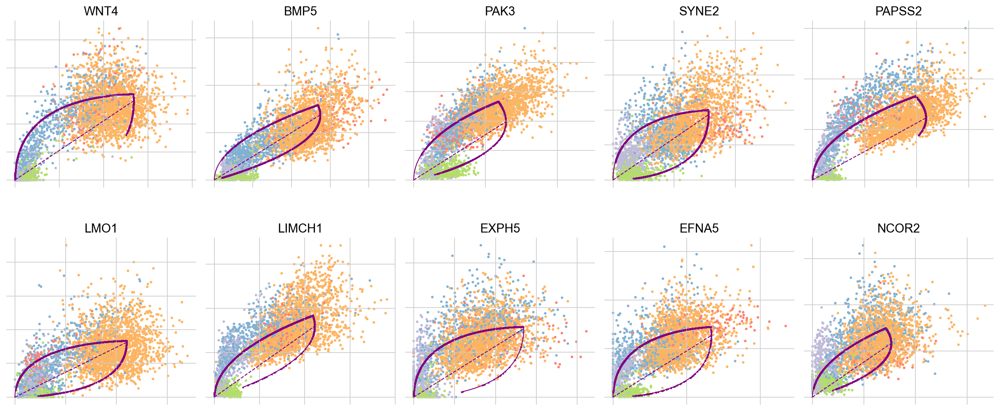

In [382]:
scv.pl.scatter(adata_74_velo_beta, ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], wspace=0.05, frameon=False, ncols=5, color='louvain_anno_fine')

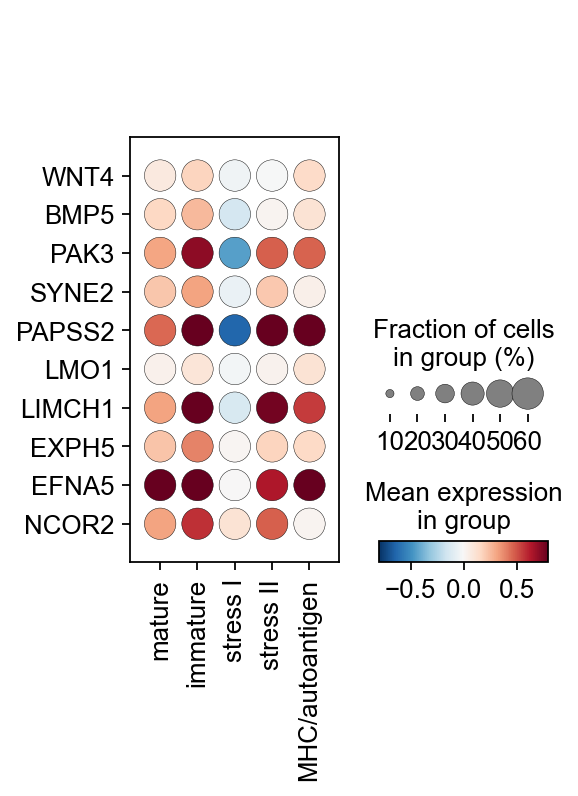

In [352]:
sc.pl.dotplot(adata_74_velo_beta, groupby='louvain_anno_fine', dot_max=0.6, layer='velocity', 
              expression_cutoff=-2,vmin=-0.8, vmax=0.8, cmap='RdBu_r',
              var_names=['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], swap_axes=True)

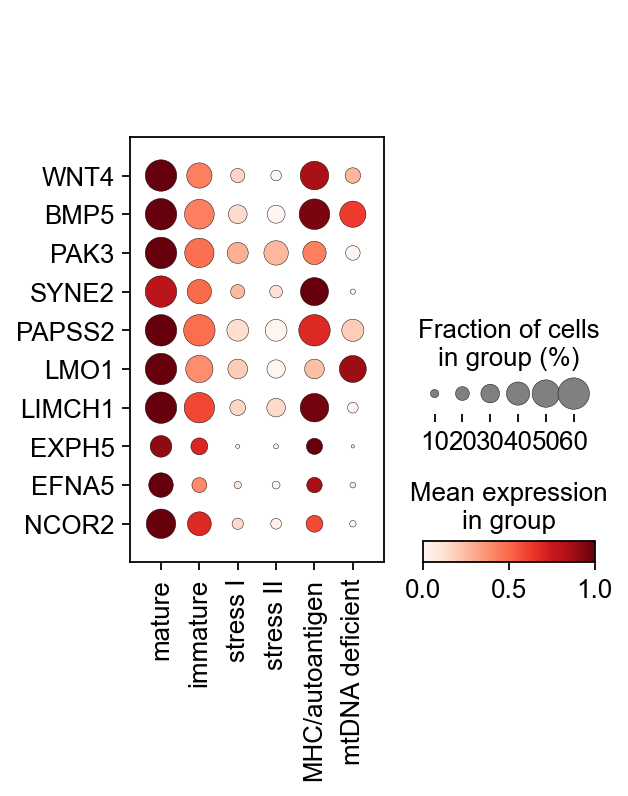

In [64]:
sc.pl.dotplot(adata_beta, groupby='louvain_anno_fine', standard_scale='var',dot_max=0.6, swap_axes=True,
              var_names=['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'])

#### mature state - high velocity expression genes

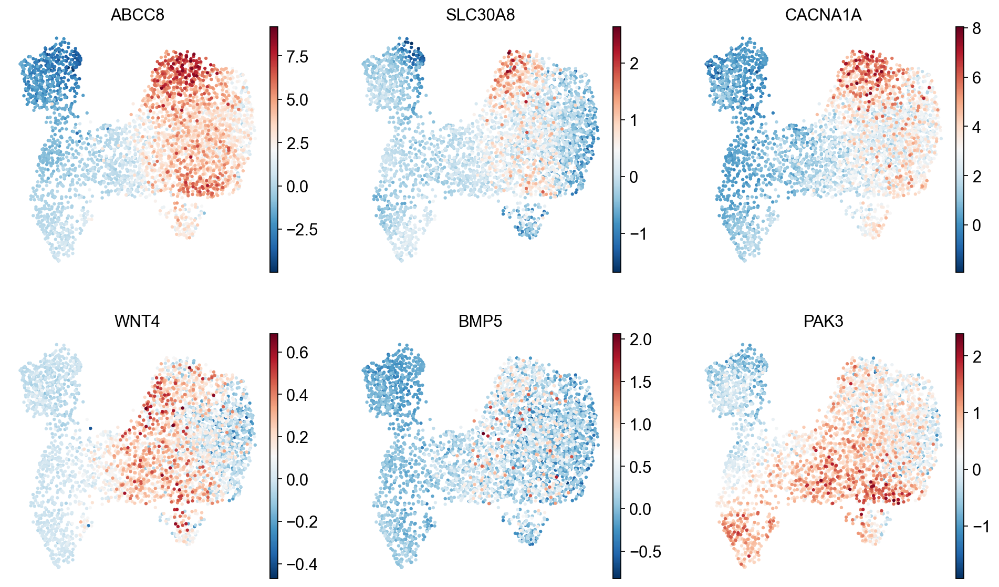

In [65]:
sc.pl.umap(adata_74_velo_beta, layer='velocity', 
           color=['ABCC8', 'SLC30A8', 'CACNA1A', 'WNT4', 'BMP5', 'PAK3'],ncols=3, cmap='RdBu_r')

In [46]:
enr = gp.enrichr(gene_list=velo_mature, gene_sets='GO_Biological_Process_2018', organism='human').res2d
enr.loc[:,'Term'] = [term.split('(')[0] for term in enr.Term]

In [639]:
enr.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2018,regulation of insulin secretion,8/98,5.133199e-07,0.002619,0,0,11.417154,165.347414,SLC30A8;RFX6;ABCC8;HNF4A;CACNA1A;EFNA5;STX1A;GCK
1,GO_Biological_Process_2018,regulation of protein secretion,7/107,1.184345e-05,0.030219,0,0,9.149729,103.792101,RFX6;ABCC8;HNF4A;CACNA1A;STX1A;GCK;LLGL2
2,GO_Biological_Process_2018,regulation of peptide hormone secretion,6/73,1.380674e-05,0.023485,0,0,11.495354,128.637079,RFX6;ABCC8;HNF4A;CACNA1A;STX1A;GCK
3,GO_Biological_Process_2018,cytoplasmic translation,5/54,4.156131e-05,0.053022,0,0,12.950013,130.644146,RPL30;RPS3A;RPS20;ZC3H15;RPS23
4,GO_Biological_Process_2018,protein K63-linked ubiquitination,4/37,1.377627e-04,0.140601,0,0,15.120015,134.416601,RNF168;HECTD1;STUB1;TRIM27
5,GO_Biological_Process_2018,viral gene expression,6/110,1.399252e-04,0.119006,0,0,7.628735,67.700463,RPS4X;RPL30;RPS20;RPS3A;RAE1;RPS23
6,GO_Biological_Process_2018,viral transcription,6/113,1.621935e-04,0.118239,0,0,7.426202,64.806388,RPS4X;RPL30;RPS20;RPS3A;RAE1;RPS23
7,GO_Biological_Process_2018,stabilization of membrane potential,3/16,1.872078e-04,0.119415,0,0,26.223776,225.086313,KCNK16;KCNK17;KCNK3
8,GO_Biological_Process_2018,SRP-dependent cotranslational protein targetin...,5/89,4.465531e-04,0.253196,0,0,7.857311,60.610924,RPS4X;RPL30;RPS3A;RPS20;RPS23
9,GO_Biological_Process_2018,cotranslational protein targeting to membrane,5/93,5.465156e-04,0.278887,0,0,7.519362,56.485056,RPS4X;RPL30;RPS3A;RPS20;RPS23


Text(0, 0.5, '')

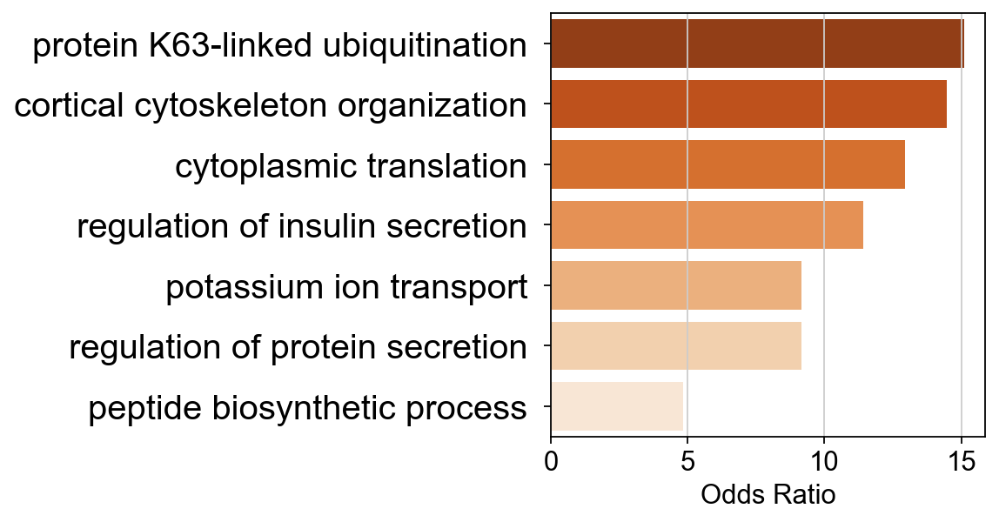

In [640]:
enr = gp.enrichr(gene_list=velo_mature, gene_sets='GO_Biological_Process_2018', organism='human').res2d
enr.loc[:,'Term'] = [term.split('(')[0] for term in enr.Term]

fig,axs = pl.subplots()
sns.barplot(data=enr.head(20).loc[[0,1,3,4,13,16,19]].sort_values(by='Odds Ratio', ascending=False),
            y='Term', x='Odds Ratio', orient='horizontal', palette='Oranges_r', ax=axs)

# i=0
# for index, row in enr.head(20).loc[[1,3,4,8,16,10]].sort_values(by='Odds Ratio', ascending=False).iterrows():
#         axs.text(row['Odds Ratio'], i, row.Genes.replace(';', ', '), color='black', ha="left", fontsize=10)
#         i+=1
axs.set_yticklabels(axs.get_yticklabels(), fontsize=18)
pl.ylabel('')
#pl.title(f'G{key}')


#### velocity clusters

In [66]:
scv.tl.rank_velocity_genes(adata_74_velo_beta, resolution=0.3)

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [73]:
adata_74_velo_beta.obs['velocity_clusters'] = [str(i) for i in adata_74_velo_beta.obs['velocity_clusters']]

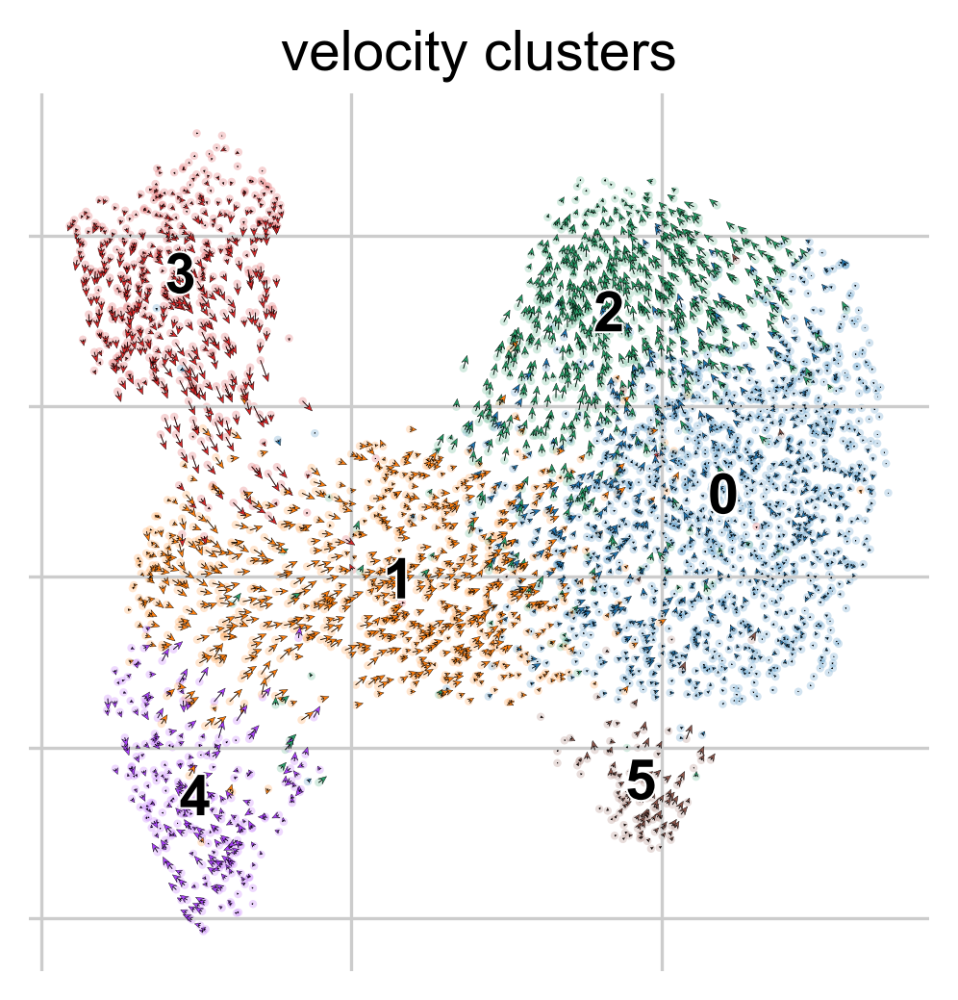

In [74]:
scv.pl.velocity_embedding(adata_74_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150, color='velocity_clusters', legend_loc='on data')

In [88]:
adata_74_proc.obs.velocity_clusters

AAACCTGAGTATTGGA-74    NaN
AAACCTGGTTTGACTG-74    NaN
AAACCTGTCAGCTCTC-74    NaN
AAACCTGTCGCTTAGA-74    NaN
AAACCTGTCGGTTAAC-74    NaN
                      ... 
TTTGTCAGTCAGCTAT-74    NaN
TTTGTCAGTCCGAATT-74    NaN
TTTGTCAGTCGGGTCT-74    NaN
TTTGTCATCCAGTAGT-74    NaN
TTTGTCATCCCACTTG-74    NaN
Name: velocity_clusters, Length: 3644, dtype: category
Categories (6, object): ['0', '1', '2', '3', '4', '5']

In [90]:
adata_74_proc.obs['velocity_clusters'] = adata_74_velo_beta.obs.velocity_clusters.tolist()

In [92]:
adata_74_proc.obs['velocity_clusters'] = adata_74_proc.obs['velocity_clusters'].astype('category')

In [93]:
map_names = {}
for c in adata_74_proc.obs['velocity_clusters'].cat.categories:
    if c in ['0']:
        map_names[c] = 'low velocity'
    elif c in ['2']:
        map_names[c] = 'high velocity'
    else:
        map_names[c] = 'other'

adata_74_proc.obs['velocity_clusters_anno'] = adata_74_proc.obs['velocity_clusters']
adata_74_proc.obs['velocity_clusters_anno'] = adata_74_proc.obs['velocity_clusters_anno'].map(map_names).astype('category')

In [94]:
adata_74_proc.uns['velocity_clusters_anno_colors'] = ['#fdb462', '#cc4c02', '#d9d9d9']

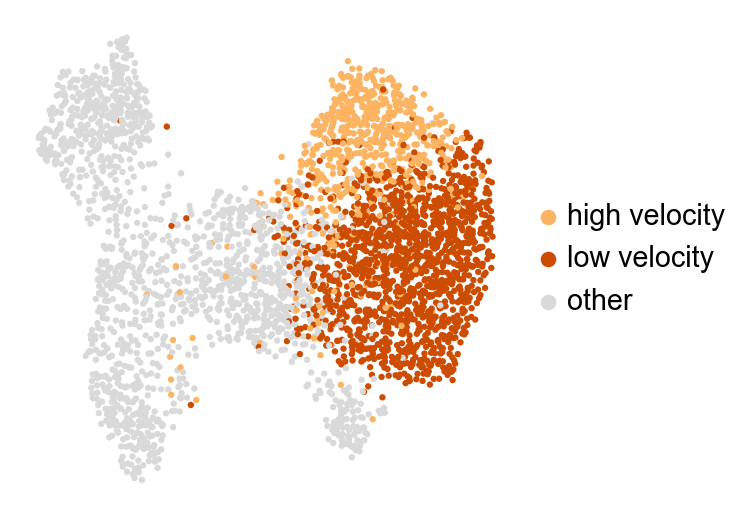

In [95]:
sc.pl.umap(adata_74_proc, color='velocity_clusters_anno', title='')

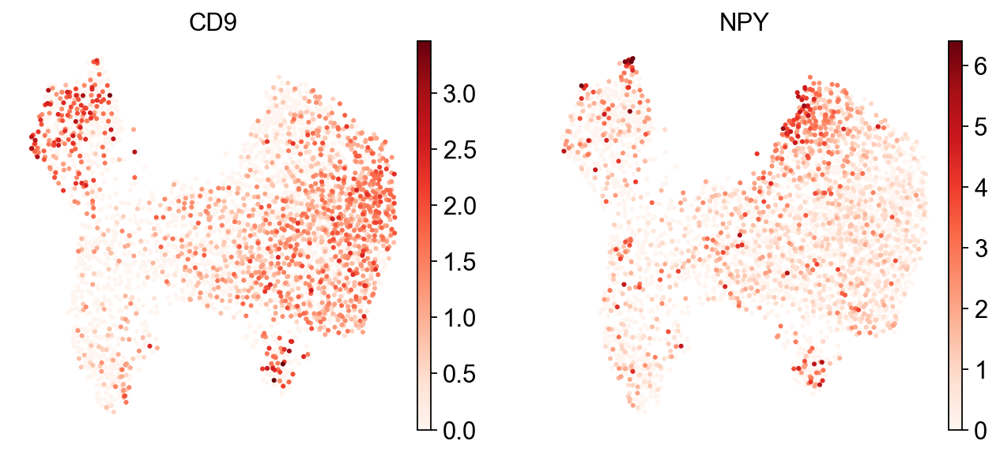

In [96]:
sc.pl.umap(adata_74_proc, color=['CD9', 'NPY'], size=30, color_map='Reds')

In [97]:
adata_sub = adata_74_proc[adata_74_proc.obs.velocity_clusters.isin(['0', '2'])].copy()

In [98]:
dorell_markers = {'CD9+': ['CD9', 'SLC44A4', 'CD74', 'TSPAN33', 'RBP4', 'PTGS2', 
                           'PPP1R1A', 'AK5', 'VWA5B2', 'ZFP36', 'SLC7A14', 'EPB41L1'],
                  'CD9-': ['NPY','FKBP5', 'HDAC9', 'PCDH7', 'SLC8A1', 'SEMA6A', 'LINGO2', 
                           'SIM1', 'TAGLN3', 'ASB9', 'TSPAN1', 'AMPH', 'KCNH7', 'KCNH1', 
                           'ADAMTS5', 'RALYL', 'DGKB', 'KLHL1']}

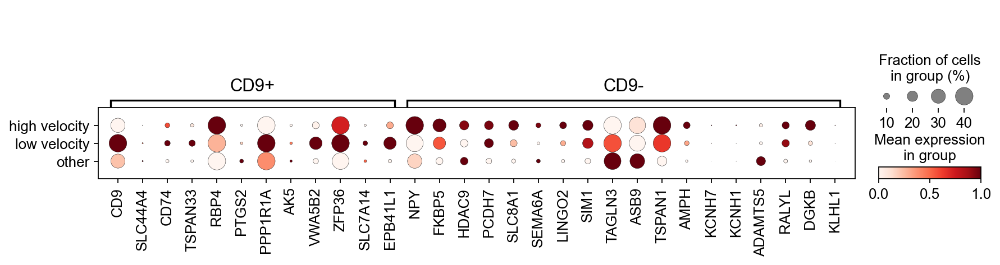

In [99]:
markers_sub = {}
for key in dorell_markers.keys():
    genes = [gene for gene in dorell_markers[key] if gene in adata_74_proc.var_names]
    if len(genes)>0:
        markers_sub[key]=genes
sc.pl.dotplot(adata_74_proc, var_names=markers_sub,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4)

#### velocity confidence

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


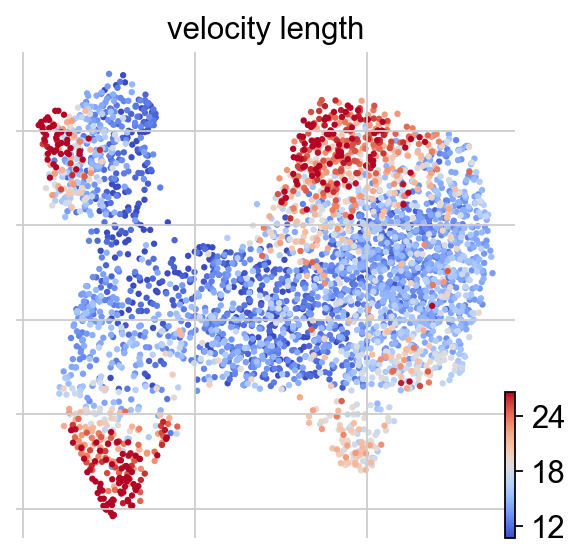

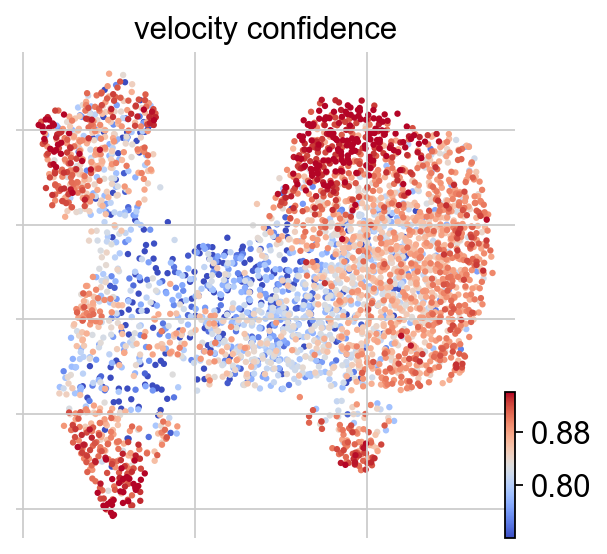

In [100]:
scv.tl.velocity_confidence(adata_74_velo_beta)
scv.pl.scatter(adata_74_velo_beta, c=['velocity_length'], cmap='coolwarm', perc=[5, 95])
scv.pl.scatter(adata_74_velo_beta, c=['velocity_confidence'], cmap='coolwarm', perc=[5, 95])

#### velocity pseudotime

In [ ]:
velo_mature = adata_74_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
velo_immature = adata_74_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_74_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()

In [103]:
scv.tl.velocity_pseudotime(adata_74_velo_beta)

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


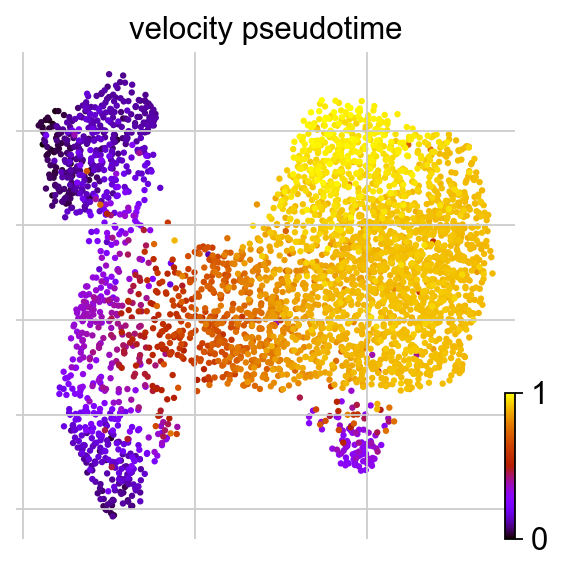

In [104]:
scv.pl.scatter(adata_74_velo_beta, color='velocity_pseudotime', cmap='gnuplot')

In [673]:
adata_74_velo_sub = adata_74_velo_beta[adata_74_velo_beta.obs.louvain_anno_fine.isin(['immature', 'mature'])].copy()

In [674]:
df = pd.DataFrame(adata_74_velo_sub[np.argsort(adata_74_velo_sub.obs.velocity_pseudotime),velo_immature_sort].layers['velocity'], columns=velo_immature_sort)
weights = np.ones(100) / 100
for gene in velo_immature_sort:
        try:
            df[velo_immature_sort] = np.convolve(df[velo_immature_sort].values, weights, mode="same")
        except:
            pass  # e.g. all-zero counts or nans cannot be convolved
        
max_sort = np.argsort(np.argmax(df.values, axis=0))
df = pd.DataFrame(df.values[:, max_sort], columns=df.columns[max_sort])

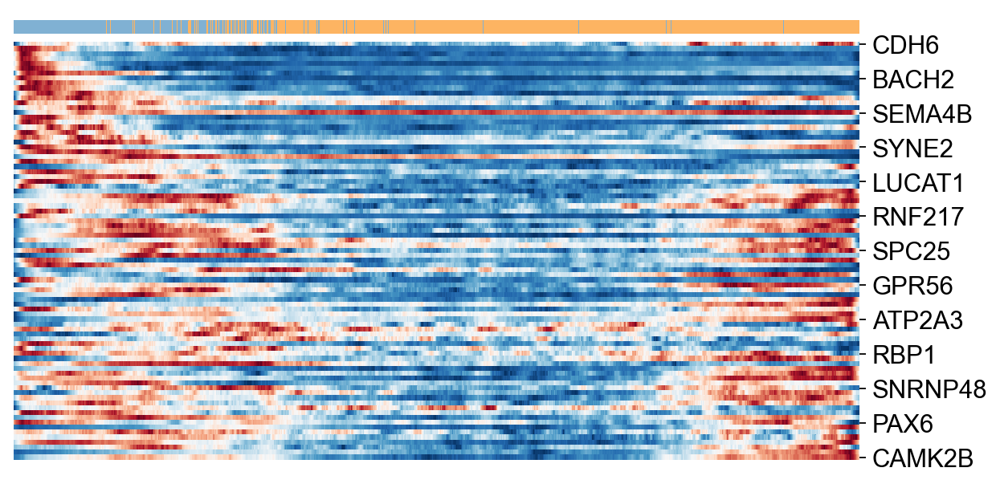

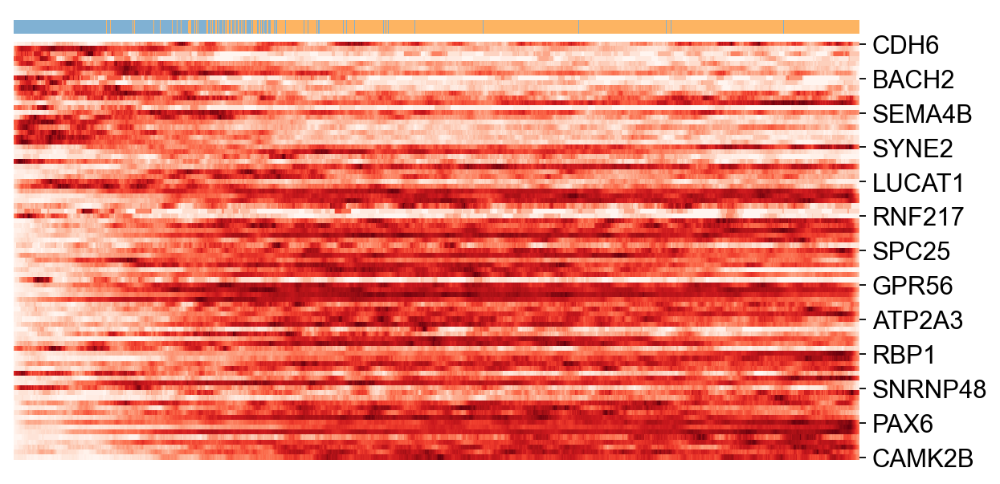

In [675]:
ax = scv.pl.heatmap(adata_74_velo_sub, var_names=df.columns, sortby='velocity_pseudotime', 
               col_color='louvain_anno_fine', n_convolve=50, layer='velocity', sort=False, color_map='RdBu_r', standard_scale=False)
scv.pl.heatmap(adata_74_velo_sub, var_names=df.columns, sortby='velocity_pseudotime', col_color='louvain_anno_fine', n_convolve=50, layer='X', sort=False, color_map='Reds')


In [676]:
df = pd.DataFrame(adata_74_velo_sub[np.argsort(adata_74_velo_sub.obs.velocity_pseudotime),velo_mature].layers['velocity'], columns=velo_mature)
weights = np.ones(100) / 100
for gene in velo_mature:
        try:
            df[velo_mature] = np.convolve(df[velo_mature].values, weights, mode="same")
        except:
            pass  # e.g. all-zero counts or nans cannot be convolved
        
max_sort = np.argsort(np.argmax(df.values, axis=0))
df = pd.DataFrame(df.values[:, max_sort], columns=df.columns[max_sort])

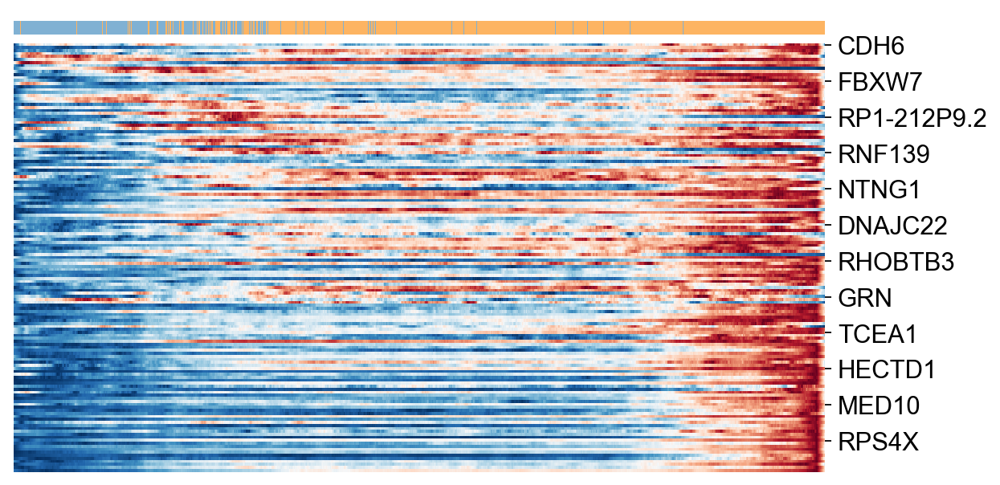

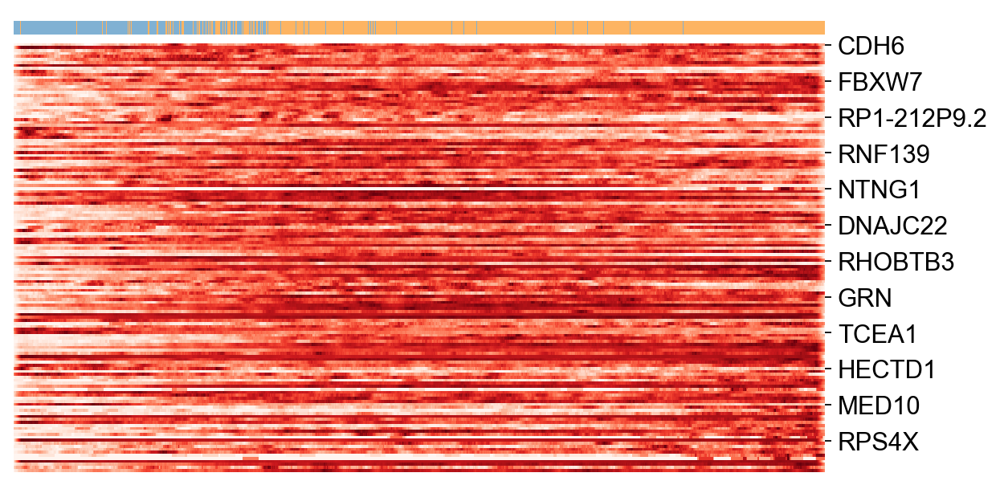

In [677]:
ax = scv.pl.heatmap(adata_74_velo_sub, var_names=df.columns, sortby='velocity_pseudotime', 
               col_color='louvain_anno_fine', n_convolve=50, layer='velocity', sort=False, color_map='RdBu_r', standard_scale=False)
scv.pl.heatmap(adata_74_velo_sub, var_names=df.columns, sortby='velocity_pseudotime', col_color='louvain_anno_fine', n_convolve=50, layer='X', sort=False, color_map='Reds')


## Beta cell donor 61

This requires to run velocyto to extract information on splices/unspliced reads

In [105]:
# load raw data
adata_raw = sc.read('../../pancreatic-endocrine-cells-cross-species/human_islets/data/GEO/human_raw.h5ad')

In [106]:
adata_raw.var

,ensembl_ID
MIR1302-10,ENSG00000243485
FAM138A,ENSG00000237613
OR4F5,ENSG00000186092
RP11-34P13.7,ENSG00000238009
RP11-34P13.8,ENSG00000239945
...,...
AC145205.1,ENSG00000215635
BAGE5,ENSG00000268590
CU459201.1,ENSG00000251180
AC002321.2,ENSG00000215616


In [107]:
adata_beta = sc.read('./data/adata_human_beta.h5ad')

In [108]:
adata_beta.obs_names = [x.replace('_1', '') for x in adata_beta.obs_names]

In [109]:
adata_beta.obs.donor.value_counts()

74    3827
63    2440
61    2196
22    1975
24    1485
Name: donor, dtype: int64

In [110]:
adata_61_velo_beta = adata_raw[adata_raw.obs['sample']=='61'].copy()

In [111]:
adata_61_velo_beta = adata_61_velo_beta[[ix for ix in adata_beta.obs_names if ix in adata_61_velo_beta.obs_names]].copy()

In [112]:
adata_61_velo_beta.obs_names

Index(['AAACCTGCACGGATAG-61', 'AAACCTGGTTTGACTG-61', 'AAACCTGTCTTACCTA-61',
       'AAACGGGAGTCCATAC-61', 'AAACGGGAGTCCCACG-61', 'AAACGGGCAAAGTGCG-61',
       'AAACGGGCATATACGC-61', 'AAAGATGAGCGTTTAC-61', 'AAAGATGGTTCCACGG-61',
       'AAAGATGTCAGCGACC-61',
       ...
       'TTTGGTTAGCTAGTTC-61', 'TTTGGTTAGGTCATCT-61', 'TTTGGTTCAGATAATG-61',
       'TTTGGTTGTCTCTTAT-61', 'TTTGGTTGTGCAGACA-61', 'TTTGGTTTCGTTTGCC-61',
       'TTTGTCAAGTACGTAA-61', 'TTTGTCACATCCGGGT-61', 'TTTGTCAGTATGCTTG-61',
       'TTTGTCATCCCTCAGT-61'],
      dtype='object', length=2196)

In [113]:
# load loom file
adata_61_loom = sc.read_loom('./data/velocity/HI_61.loom')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [114]:
adata_61_loom.obs_names

Index(['HI_61:AAAGCAAAGGATGCGTx', 'HI_61:AAAGATGCAGCTGTTAx',
       'HI_61:AAAGCAACACTCTGTCx', 'HI_61:AAATGCCGTTGTGGAGx',
       'HI_61:AAACGGGCAAAGTGCGx', 'HI_61:AAAGATGAGGAGTACCx',
       'HI_61:AAACCTGCATTCGACAx', 'HI_61:AAACCTGGTTTGACTGx',
       'HI_61:AAACCTGTCGTGGTCGx', 'HI_61:AAATGCCCACCCTATCx',
       ...
       'HI_61:TTTATGCGTCACTGGCx', 'HI_61:TTTGCGCTCGCACTCTx',
       'HI_61:TTTCCTCTCTCCTATAx', 'HI_61:TTTGGTTCAGACAAATx',
       'HI_61:TTTCCTCTCCTTTACAx', 'HI_61:TTTGCGCCATGCTAGTx',
       'HI_61:TTTATGCGTAGCGCAAx', 'HI_61:TTTGTCAGTAAACCTCx',
       'HI_61:TTTATGCTCTATCCCGx', 'HI_61:TTTGCGCAGCAGGCTAx'],
      dtype='object', name='CellID', length=8985)

In [115]:
adata_61_loom.obs_names[0]

'HI_61:AAAGCAAAGGATGCGTx'

In [116]:
adata_61_velo_beta.obs_names

Index(['AAACCTGCACGGATAG-61', 'AAACCTGGTTTGACTG-61', 'AAACCTGTCTTACCTA-61',
       'AAACGGGAGTCCATAC-61', 'AAACGGGAGTCCCACG-61', 'AAACGGGCAAAGTGCG-61',
       'AAACGGGCATATACGC-61', 'AAAGATGAGCGTTTAC-61', 'AAAGATGGTTCCACGG-61',
       'AAAGATGTCAGCGACC-61',
       ...
       'TTTGGTTAGCTAGTTC-61', 'TTTGGTTAGGTCATCT-61', 'TTTGGTTCAGATAATG-61',
       'TTTGGTTGTCTCTTAT-61', 'TTTGGTTGTGCAGACA-61', 'TTTGGTTTCGTTTGCC-61',
       'TTTGTCAAGTACGTAA-61', 'TTTGTCACATCCGGGT-61', 'TTTGTCAGTATGCTTG-61',
       'TTTGTCATCCCTCAGT-61'],
      dtype='object', length=2196)

In [117]:
# adapt obs_names to match
adata_61_loom.obs_names = [x[6:22] +'-61' for x in adata_61_loom.obs_names]

In [118]:
# filter and sort velocity/loom adata
adata_61_loom = adata_61_loom[[x for x in adata_61_velo_beta.obs_names if x in adata_61_loom.obs_names]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [119]:
adata_61_loom

AnnData object with n_obs × n_vars = 2196 × 32738
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [120]:
adata_61_loom.var_names_make_unique()

In [121]:
adata_61_loom.var_names

Index(['FAM138A', 'RP11-34P13.7', 'RP11-34P13.8', 'AL627309.1',
       'RP11-34P13.14', 'AP006222.2', 'RP4-669L17.2', 'RP5-857K21.1',
       'RP5-857K21.3', 'RP5-857K21.4',
       ...
       'BPY2', 'DAZ2', 'AC016752.1', 'TTTY17B', 'TTTY4B', 'BPY2B', 'DAZ4',
       'CSPG4P1Y', 'CDY1', 'TTTY3'],
      dtype='object', name='Gene', length=32738)

In [122]:
adata_61_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [123]:
adata_61_loom = adata_61_loom[:,[x for x in adata_61_velo_beta.var_names if x in adata_61_loom.var_names]].copy()

In [124]:
# add unspliced/spliced count information to raw data
adata_61_velo_beta.layers['matrix'] = adata_61_loom.layers['matrix']
adata_61_velo_beta.layers['ambiguous'] = adata_61_loom.layers['ambiguous']
adata_61_velo_beta.layers['spliced'] = adata_61_loom.layers['spliced']
adata_61_velo_beta.layers['unspliced'] = adata_61_loom.layers['unspliced']
del adata_61_loom

In [125]:
adata_61_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [126]:
# subset to donor 61 to get meta data
adata_61_proc = adata_beta[np.isin(adata_beta.obs['donor'], ['61'])].copy()

In [127]:
# add metadata
adata_61_velo_beta.obs = adata_61_proc.obs.loc[adata_61_velo_beta.obs_names].copy()

In [128]:
# normalize raw data using exclude_highly_expressed
sc.pp.normalize_total(adata_61_velo_beta, exclude_highly_expressed=True)
sc.pp.log1p(adata_61_velo_beta)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['GCG', 'SST', 'RBP4', 'INS', 'FTH1', 'MALAT1', 'IAPP', 'TTR', 'FTL']
    finished (0:00:00)


In [129]:
# exlude mtDNA deficient subtype
adata_61_proc = adata_61_proc[np.invert(adata_61_proc.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [130]:
# compute manifold
sc.pp.pca(adata_61_proc)
sc.pp.neighbors(adata_61_proc)
sc.tl.umap(adata_61_proc)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [131]:
len(set(adata_61_proc.obs_names).intersection(adata_61_velo_beta.obs_names))

2158

In [132]:
adata_61_velo_beta = adata_61_velo_beta[np.invert(adata_61_velo_beta.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [133]:
adata_61_velo_beta.obsm['X_umap'] = adata_61_proc.obsm['X_umap']

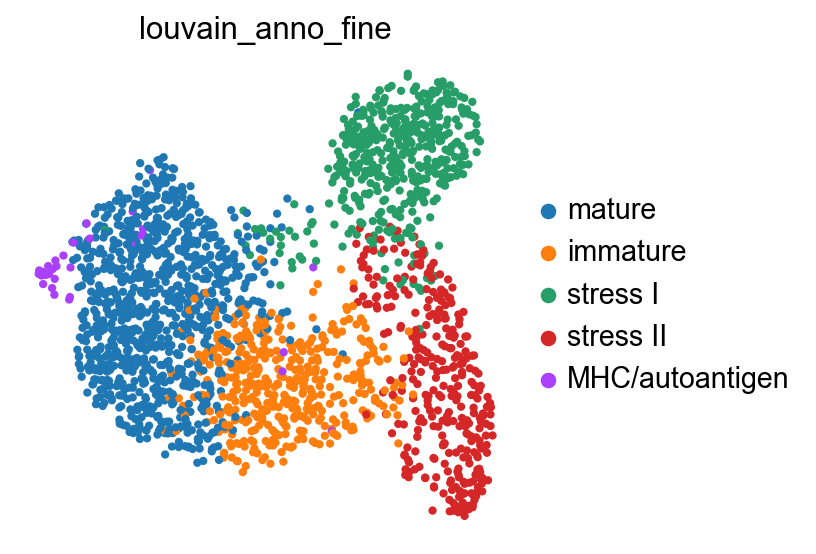

In [134]:
sc.pl.umap(adata_61_velo_beta,color='louvain_anno_fine')

In [135]:
scv.pp.filter_and_normalize(adata_61_velo_beta, min_shared_counts=10, n_top_genes=4000, min_cells_u=10)

Filtered out 18340 genes that are detected in less than 10 cells (unspliced).
Filtered out 5963 genes that are detected 10 counts (shared).
Normalized count data: spliced, unspliced.
Exctracted 4000 highly variable genes.


In [136]:
scv.pp.moments(adata_61_velo_beta)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:00)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [137]:
scv.tl.velocity(adata_61_velo_beta)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [138]:
%%time
scv.tl.recover_dynamics(adata_61_velo_beta)

recovering dynamics
    finished (0:03:39) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
CPU times: user 3min 38s, sys: 655 ms, total: 3min 39s
Wall time: 3min 39s


In [139]:
top_genes = adata_61_velo_beta.var['fit_likelihood'].sort_values(ascending=False)[adata_61_velo_beta.var['fit_likelihood'].sort_values(ascending=False)>0.1].index
scv.tl.differential_kinetic_test(adata_61_velo_beta, var_names=top_genes, groupby='louvain_anno_fine')

testing for differential kinetics
    finished (0:00:47) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [140]:
len(top_genes)

663

In [141]:
adata_61_velo_beta.uns['louvain_anno_fine_colors'] = adata_beta.uns['louvain_anno_fine_colors'][0:5]

In [142]:
scv.tl.velocity(adata_61_velo_beta, diff_kinetics=False)
scv.tl.velocity_graph(adata_61_velo_beta, gene_subset=top_genes)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


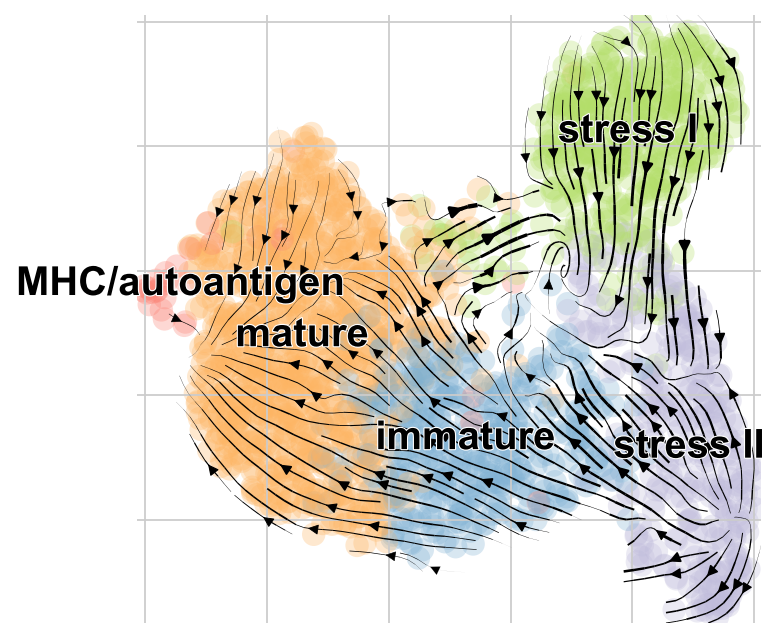

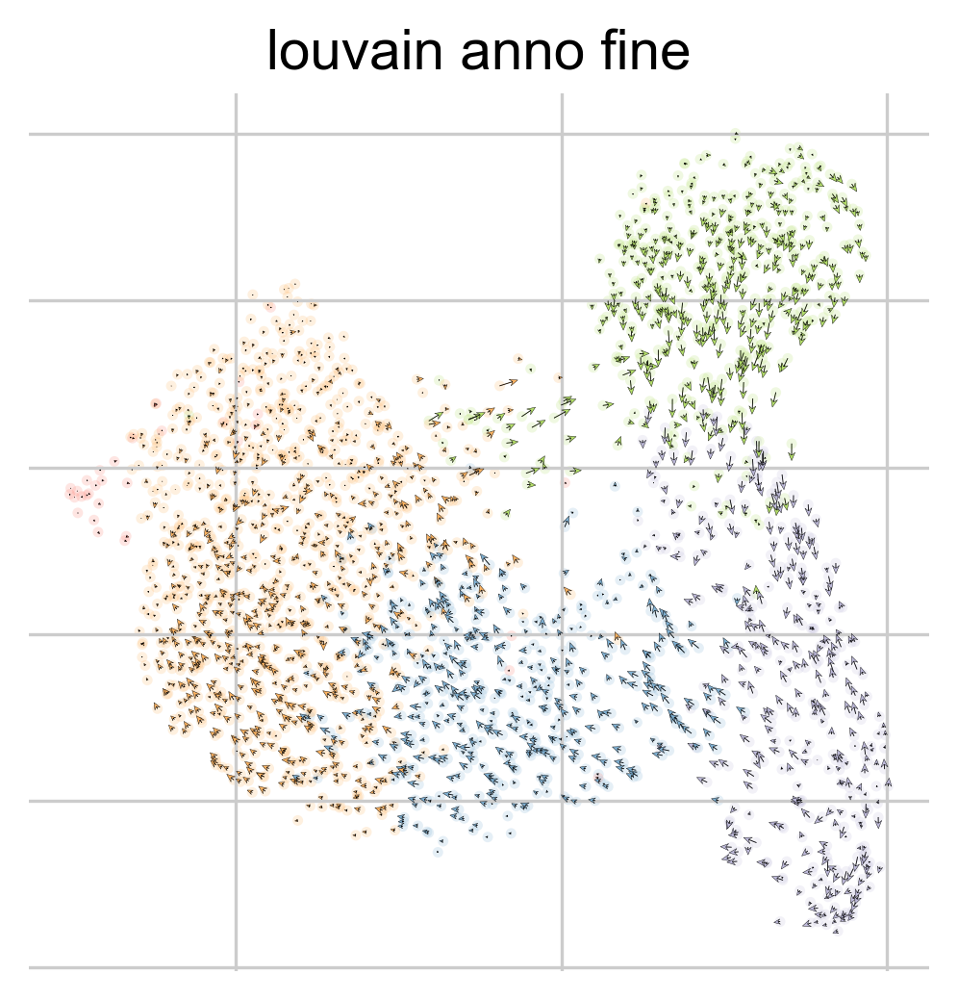

In [143]:
scv.pl.velocity_embedding_stream(adata_61_velo_beta, basis='umap',color='louvain_anno_fine',figsize=(5,5), legend_fontsize=18, title='')
scv.pl.velocity_embedding(adata_61_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='louvain_anno_fine')

#### differential velocyto expression test

In [144]:
scv.tl.rank_velocity_genes(adata_61_velo_beta, groupby='louvain_anno_fine', n_genes=1800, min_likelihood=0.1)
df = scv.DataFrame(adata_61_velo_beta.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:02) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,mature,immature,stress I,stress II,MHC/autoantigen
0,SIPA1L3,PAPSS2,ZNF556,NAPA,TGFBR3
1,ROBO2,RAP1GAP2,CDH17,CCDC18,FKBP5
2,HSPA8,LIMCH1,RP11-58E21.4,AAK1,ASAP1
3,ZNF385D,EXPH5,TEKT1,CADPS2,LMO1
4,PRMT2,FNIP2,CELF5,WARS,ELMO1
5,SPPL2A,WNT4,ALOX15B,MAGT1,SORBS2
6,CACNA1D,HSD17B12,PDE4C,RP11-3L8.3,ELAVL4
7,PCDH7,KCNJ6,DHDH,RRAS2,SMAD1
8,TSC22D1,GPR56,SYNPO2,FBXO16,RAP1GAP2
9,MSI2,PRKAA2,STX3,RP11-37N22.1,MPP6


##### Supplementary Table 4

In [145]:
velo_mature = adata_61_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_61_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
velo_immature = adata_61_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_61_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()
velo_stress_I = adata_61_velo_beta.uns['rank_velocity_genes']['names']['stress I'][adata_61_velo_beta.uns['rank_velocity_genes']['scores']['stress I']>2].tolist()
velo_stress_II = adata_61_velo_beta.uns['rank_velocity_genes']['names']['stress II'][adata_61_velo_beta.uns['rank_velocity_genes']['scores']['stress II']>2].tolist()

In [146]:
velo_mature_74 = pd.read_excel('../../pancreatic-endocrine-cells-cross-species/human_islets/Supplementary_Table_4.xlsx', skiprows=2, index_col=0)

In [147]:
velo_immature_74 = pd.read_excel('../../pancreatic-endocrine-cells-cross-species/human_islets/Supplementary_Table_4.xlsx', 
                                 skiprows=2, index_col=0, sheet_name='immature')

In [148]:
print(f'donor 74: {len(velo_mature_74)}')
print(f'donor 61: {len(velo_mature)}')
print(f'61 & 74: {len(set(velo_mature_74.names).intersection(velo_mature))}')

donor 74: 143
donor 61: 220
61 & 74: 63


In [149]:
print(f'donor 74: {len(velo_immature_74)}')
print(f'donor 61: {len(velo_immature)}')
print(f'61 & 74: {len(set(velo_immature_74.names).intersection(velo_immature))}')

donor 74: 85
donor 61: 133
61 & 74: 35


#### immature state - high velocity expression genes

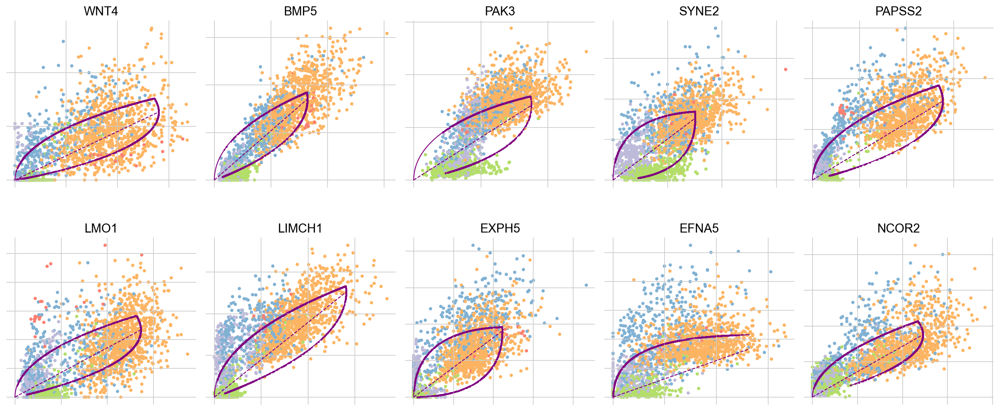

In [150]:
scv.pl.scatter(adata_61_velo_beta, ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], wspace=0.05, frameon=False, ncols=5, color='louvain_anno_fine')

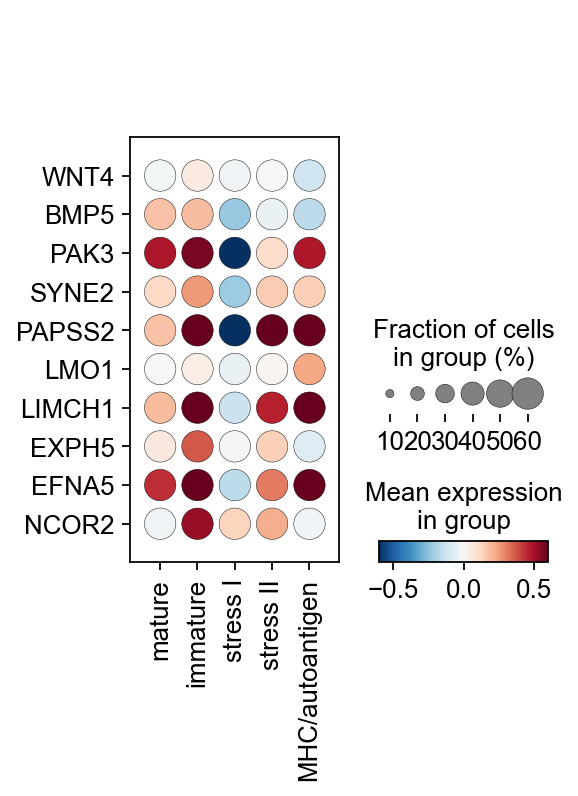

In [353]:
sc.pl.dotplot(adata_61_velo_beta, groupby='louvain_anno_fine', dot_max=0.6, layer='velocity', 
              expression_cutoff=-2,vmin=-0.6, vmax=0.6, cmap='RdBu_r',
              var_names=['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], swap_axes=True)

#### mature state - high velocity expression genes

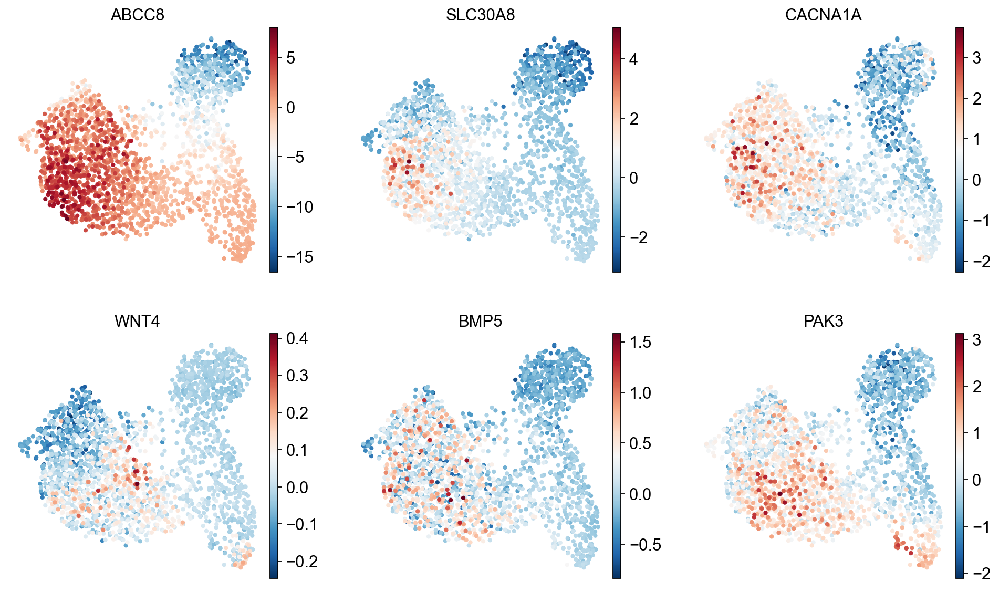

In [152]:
sc.pl.umap(adata_61_velo_beta, layer='velocity', 
           color=['ABCC8', 'SLC30A8', 'CACNA1A', 'WNT4', 'BMP5', 'PAK3'],ncols=3, cmap='RdBu_r')

#### velocity clusters

In [368]:
scv.tl.rank_velocity_genes(adata_61_velo_beta, resolution=0.4)

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [369]:
adata_61_velo_beta.obs['velocity_clusters_str'] = [str(i) for i in adata_61_velo_beta.obs['velocity_clusters']]

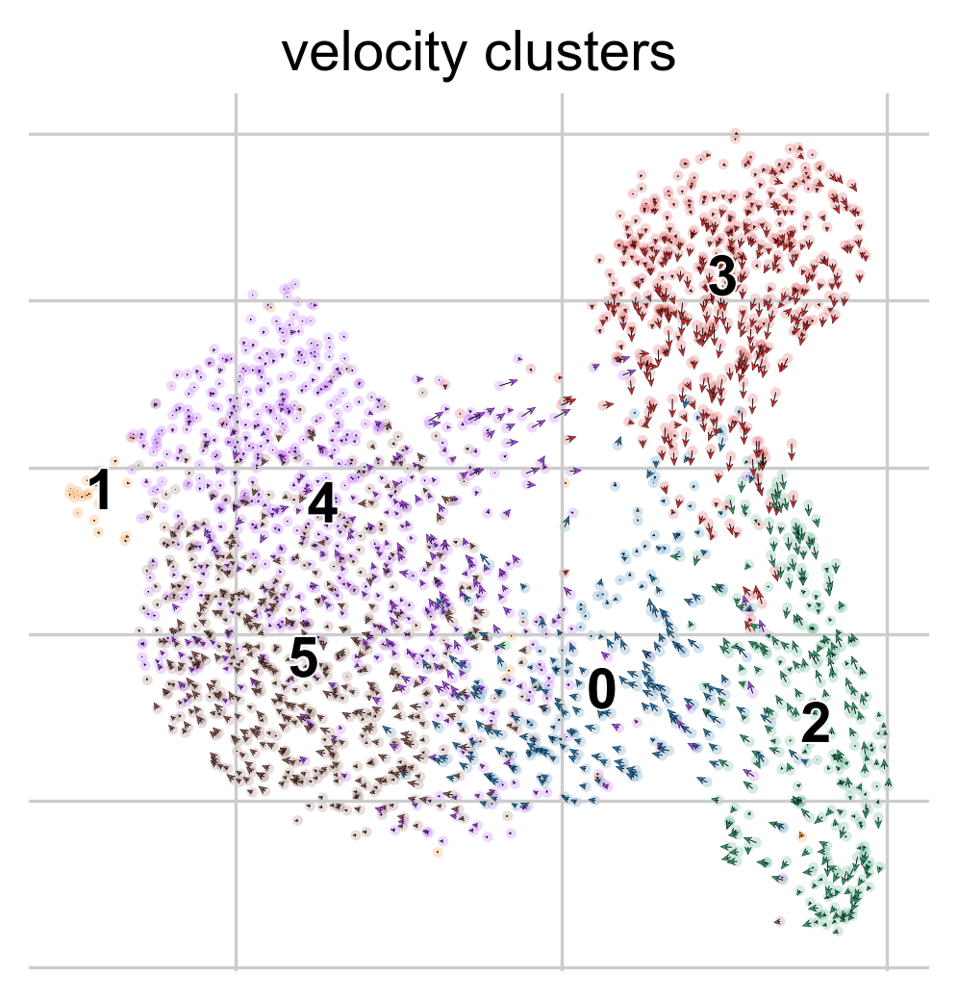

In [370]:
scv.pl.velocity_embedding(adata_61_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='velocity_clusters', legend_loc='on data')

In [371]:
adata_61_proc.obs['velocity_clusters'] = adata_61_velo_beta.obs.velocity_clusters

In [372]:
map_names = {}
for c in adata_61_proc.obs['velocity_clusters'].cat.categories:
    if c in ['4']:
        map_names[c] = 'low velocity'
    elif c in ['5']:
        map_names[c] = 'high velocity'
    else:
        map_names[c] = 'other'

adata_61_proc.obs['velocity_clusters_anno']=adata_61_proc.obs['velocity_clusters']
adata_61_proc.obs['velocity_clusters_anno']=adata_61_proc.obs['velocity_clusters_anno'].map(map_names).astype('category')

In [466]:
adata_61_proc.uns['velocity_clusters_anno_colors'] = ['#cc4c02', '#fdb462',  '#d9d9d9']

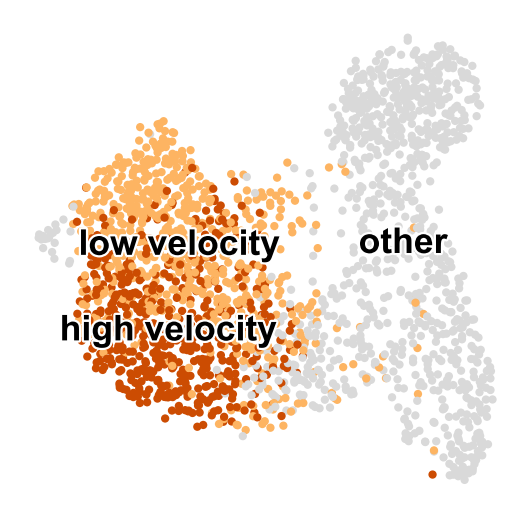

In [467]:
sc.pl.umap(adata_61_proc, color='velocity_clusters_anno', title='', legend_loc='on data', legend_fontoutline=2, legend_fontsize=16)

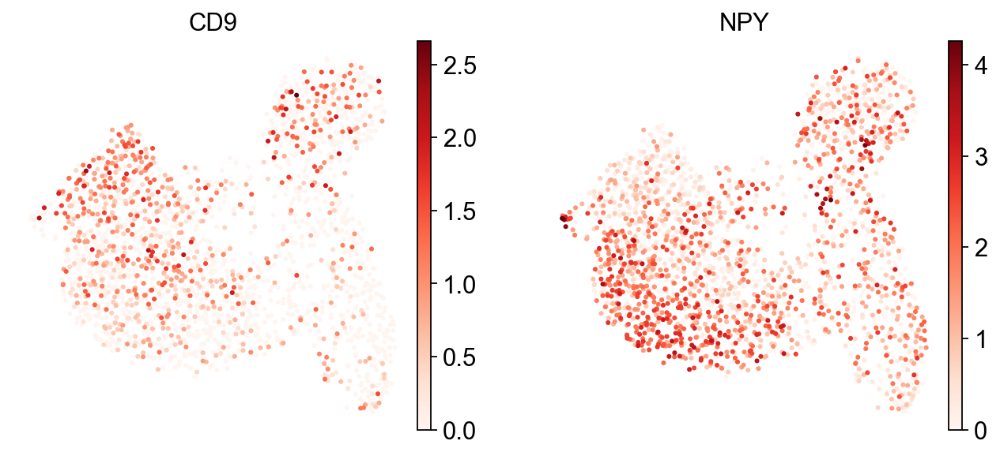

In [375]:
sc.pl.umap(adata_61_proc, color=['CD9', 'NPY'], size=30, color_map='Reds')

In [395]:
dorell_markers = {'CD9+': ['CD9', 'SLC44A4', 'CD74', 'TSPAN33', 'RBP4', 'PTGS2', 
                           'PPP1R1A', 'AK5', 'VWA5B2', 'ZFP36', 'SLC7A14', 'EPB41L1'],
                  'CD9-': ['NPY','FKBP5', 'HDAC9', 'PCDH7', 'SLC8A1', 'SEMA6A', 'LINGO2', 
                           'SIM1', 'TAGLN3', 'ASB9', 'TSPAN1', 'AMPH', 'KCNH7', 'KCNH1', 
                           'ADAMTS5', 'RALYL', 'DGKB', 'KLHL1']}

In [398]:
dorell_markers_genes = ['CD9', 'SLC44A4', 'CD74', 'TSPAN33', 'RBP4', 'PTGS2', 
                        'PPP1R1A', 'AK5', 'VWA5B2', 'ZFP36', 'SLC7A14', 'EPB41L1', 
                        'NPY','FKBP5', 'HDAC9', 'PCDH7', 'SLC8A1', 'SEMA6A', 'LINGO2', 
                        'SIM1', 'TAGLN3', 'ASB9', 'TSPAN1', 'AMPH', 'KCNH7', 'KCNH1', 
                        'ADAMTS5', 'RALYL', 'DGKB', 'KLHL1']

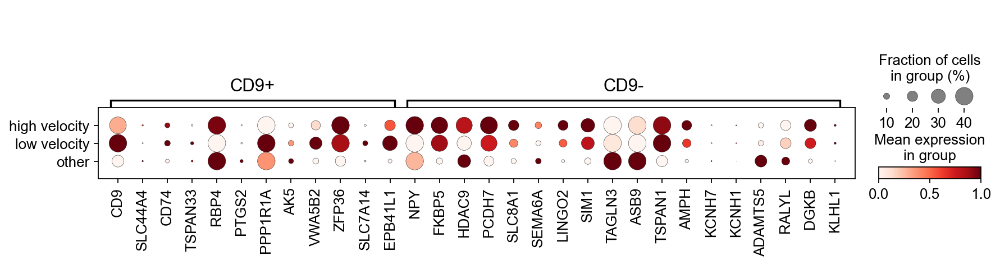

In [397]:
markers_sub = {}
for key in dorell_markers.keys():
    genes = [gene for gene in dorell_markers[key] if gene in adata_61_proc.var_names]
    if len(genes)>0:
        markers_sub[key]=genes
sc.pl.dotplot(adata_61_proc, var_names=markers_sub,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4)

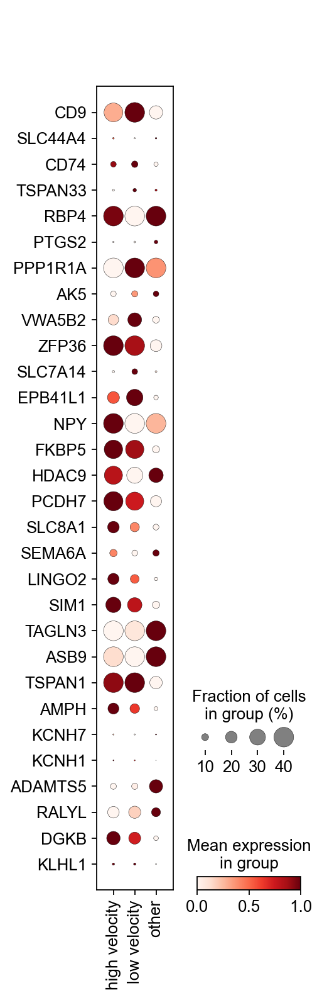

In [399]:
sc.pl.dotplot(adata_61_proc, var_names=dorell_markers_genes,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4, swap_axes=True)

## Beta cell donor 63

This requires to run velocyto to extract information on splices/unspliced reads

In [163]:
adata_beta.obs.donor.value_counts()

74    3827
63    2440
61    2196
22    1975
24    1485
Name: donor, dtype: int64

In [164]:
adata_63_velo_beta = adata_raw[adata_raw.obs['sample']=='63'].copy()

In [165]:
adata_63_velo_beta = adata_63_velo_beta[[ix for ix in adata_beta.obs_names if ix in adata_63_velo_beta.obs_names]].copy()

In [166]:
adata_63_velo_beta

AnnData object with n_obs × n_vars = 2440 × 32738
    obs: 'sample'
    var: 'ensembl_ID'

In [167]:
# load loom file
adata_63_loom = sc.read_loom('./data/velocity/HI_63.loom')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [168]:
adata_63_loom.obs_names

Index(['HI_63:AAAGCAATCTATGTGGx', 'HI_63:AAAGTAGAGGGTTCCCx',
       'HI_63:AAATGCCAGGCCCTCAx', 'HI_63:AAACCTGCAAGAGGCTx',
       'HI_63:AAACCTGAGGAGTAGAx', 'HI_63:AAAGATGCAAACAACAx',
       'HI_63:AAACGGGGTGAAATCAx', 'HI_63:AAATGCCAGGGTGTGTx',
       'HI_63:AAAGATGGTAGCGCTCx', 'HI_63:AAACGGGCAGGGAGAGx',
       ...
       'HI_63:TTTGGTTAGTGGACGTx', 'HI_63:TTTCCTCTCGGCGCTAx',
       'HI_63:TTTGGTTCACAGATTCx', 'HI_63:TTTGGTTAGTGGGTTGx',
       'HI_63:TTTGGTTGTGCCTGTGx', 'HI_63:TTTGTCAGTCGCATATx',
       'HI_63:TTTCCTCTCCCTGACTx', 'HI_63:TTTGCGCAGACTGTAAx',
       'HI_63:TTTGTCATCCAAGTACx', 'HI_63:TTTGCGCAGATCACGGx'],
      dtype='object', name='CellID', length=8559)

In [169]:
adata_63_velo_beta.obs_names

Index(['AAACCTGAGCTGCGAA-63', 'AAACCTGAGGCCGAAT-63', 'AAACCTGCAGTGAGTG-63',
       'AAACCTGTCCGTACAA-63', 'AAACGGGCATATACGC-63', 'AAACGGGCATTTCAGG-63',
       'AAACGGGTCGTAGATC-63', 'AAACGGGTCGTGGACC-63', 'AAAGATGAGTTACCCA-63',
       'AAAGATGCAGTGACAG-63',
       ...
       'TTTGCGCGTGAGGCTA-63', 'TTTGCGCTCCGATATG-63', 'TTTGGTTAGCTAGGCA-63',
       'TTTGGTTAGTGGACGT-63', 'TTTGGTTGTGCCTGTG-63', 'TTTGGTTGTTAAGTAG-63',
       'TTTGTCAAGGGATCTG-63', 'TTTGTCATCAAGGCTT-63', 'TTTGTCATCATGTAGC-63',
       'TTTGTCATCCAAGTAC-63'],
      dtype='object', length=2440)

In [170]:
# adapt obs_names to match
adata_63_loom.obs_names = [x[6:22] +'-63' for x in adata_63_loom.obs_names]

In [171]:
# filter and sort velocity/loom adata
adata_63_loom = adata_63_loom[[x for x in adata_63_velo_beta.obs_names if x in adata_63_loom.obs_names]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [172]:
adata_63_loom

AnnData object with n_obs × n_vars = 2440 × 32738
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [173]:
adata_63_loom.var_names_make_unique()

In [174]:
adata_63_loom.var_names

Index(['FAM138A', 'RP11-34P13.7', 'RP11-34P13.8', 'AL627309.1',
       'RP11-34P13.14', 'AP006222.2', 'RP4-669L17.2', 'RP5-857K21.1',
       'RP5-857K21.3', 'RP5-857K21.4',
       ...
       'BPY2', 'DAZ2', 'AC016752.1', 'TTTY17B', 'TTTY4B', 'BPY2B', 'DAZ4',
       'CSPG4P1Y', 'CDY1', 'TTTY3'],
      dtype='object', name='Gene', length=32738)

In [175]:
adata_63_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [176]:
adata_63_loom = adata_63_loom[:,[x for x in adata_63_velo_beta.var_names if x in adata_63_loom.var_names]].copy()

In [177]:
# add unspliced/spliced count information to raw data
adata_63_velo_beta.layers['matrix'] = adata_63_loom.layers['matrix']
adata_63_velo_beta.layers['ambiguous'] = adata_63_loom.layers['ambiguous']
adata_63_velo_beta.layers['spliced'] = adata_63_loom.layers['spliced']
adata_63_velo_beta.layers['unspliced'] = adata_63_loom.layers['unspliced']
del adata_63_loom

In [178]:
adata_63_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [179]:
# subset to donor 61 to get meta data
adata_63_proc = adata_beta[np.isin(adata_beta.obs['donor'], ['63'])].copy()

In [180]:
# add metadata
adata_63_velo_beta.obs = adata_63_proc.obs.loc[adata_63_velo_beta.obs_names].copy()

In [181]:
# normalize raw data using exclude_highly_expressed
sc.pp.normalize_total(adata_63_velo_beta, exclude_highly_expressed=True)
sc.pp.log1p(adata_63_velo_beta)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['GCG', 'GHRL', 'SST', 'INS', 'FTH1', 'MALAT1', 'IAPP', 'FTL']
    finished (0:00:00)


In [182]:
# exlude mtDNA deficient subtype
adata_63_proc = adata_63_proc[np.invert(adata_63_proc.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [183]:
# compute manifold
sc.pp.pca(adata_63_proc)
sc.pp.neighbors(adata_63_proc)
sc.tl.umap(adata_63_proc)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [184]:
len(set(adata_63_proc.obs_names).intersection(adata_63_velo_beta.obs_names))

2406

In [185]:
adata_63_velo_beta = adata_63_velo_beta[np.invert(adata_63_velo_beta.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [186]:
adata_63_velo_beta.obsm['X_umap'] = adata_63_proc.obsm['X_umap']

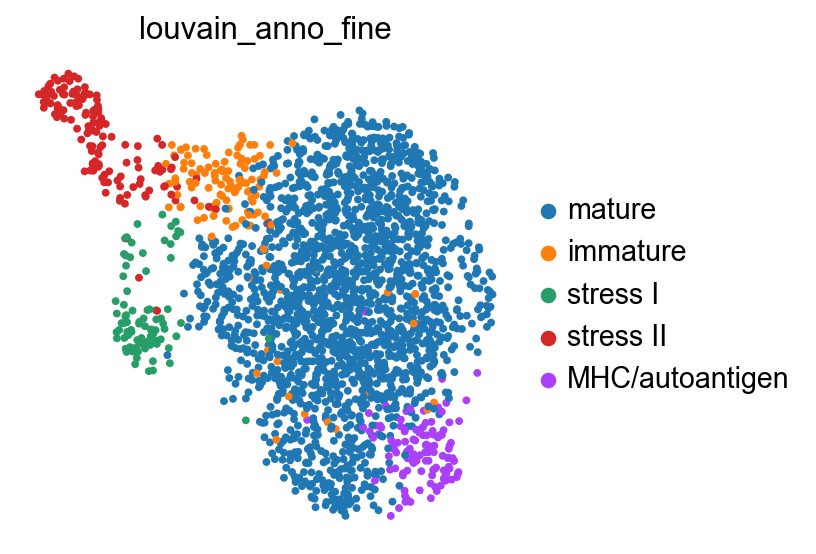

In [187]:
sc.pl.umap(adata_63_velo_beta,color='louvain_anno_fine')

In [188]:
scv.pp.filter_and_normalize(adata_63_velo_beta, min_shared_counts=10, n_top_genes=4000, min_cells_u=10)

Filtered out 17885 genes that are detected in less than 10 cells (unspliced).
Filtered out 5754 genes that are detected 10 counts (shared).
Normalized count data: spliced, unspliced.
Exctracted 4000 highly variable genes.


In [189]:
scv.pp.moments(adata_63_velo_beta)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:01)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [190]:
scv.tl.velocity(adata_63_velo_beta)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [191]:
%%time
scv.tl.recover_dynamics(adata_63_velo_beta)

recovering dynamics
    finished (0:03:06) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
CPU times: user 3min 5s, sys: 495 ms, total: 3min 6s
Wall time: 3min 6s


In [192]:
top_genes = adata_63_velo_beta.var['fit_likelihood'].sort_values(ascending=False)[adata_63_velo_beta.var['fit_likelihood'].sort_values(ascending=False)>0.1].index
scv.tl.differential_kinetic_test(adata_63_velo_beta, var_names=top_genes, groupby='louvain_anno_fine')

testing for differential kinetics
    finished (0:00:28) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [193]:
len(top_genes)

363

In [194]:
adata_63_velo_beta.uns['louvain_anno_fine_colors'] = adata_beta.uns['louvain_anno_fine_colors'][0:5]

In [195]:
scv.tl.velocity(adata_63_velo_beta, diff_kinetics=False)
scv.tl.velocity_graph(adata_63_velo_beta, gene_subset=top_genes)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


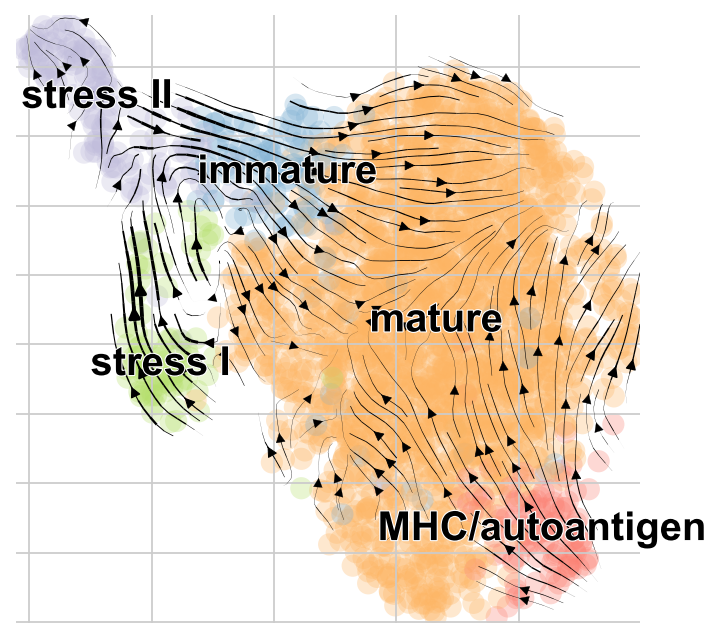

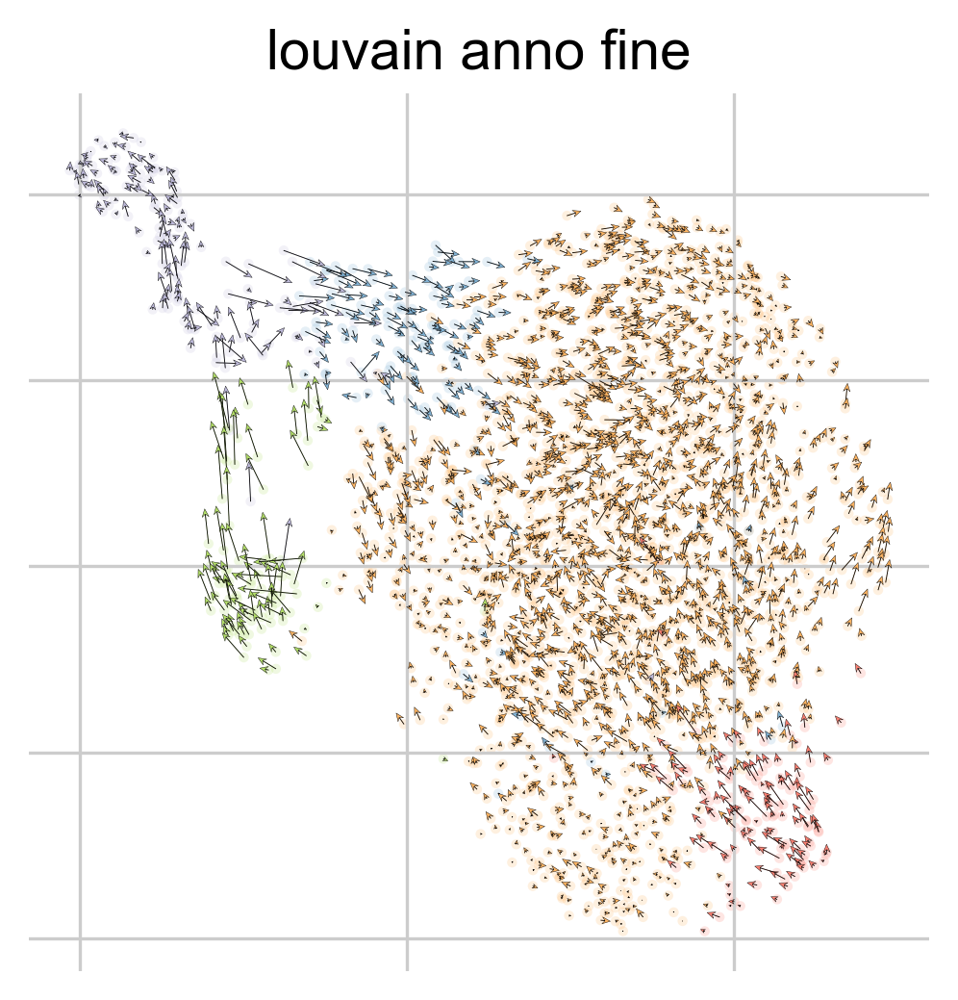

In [196]:
scv.pl.velocity_embedding_stream(adata_63_velo_beta, basis='umap',color='louvain_anno_fine',figsize=(5,5), legend_fontsize=18, title='')
scv.pl.velocity_embedding(adata_63_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='louvain_anno_fine')

#### differential velocyto expression test

In [197]:
scv.tl.rank_velocity_genes(adata_63_velo_beta, groupby='louvain_anno_fine', n_genes=1800, min_likelihood=0.1)
df = scv.DataFrame(adata_63_velo_beta.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:02) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,mature,immature,stress I,stress II,MHC/autoantigen
0,ABCC8,PAPSS2,PDE4C,EML5,ETV5
1,GIPR,EXPH5,GINS3,CREB5,ELMO1
2,NAV2,SORL1,LMLN,MTFR1,NCAM2
3,ZNF385D,ETV1,ERN1,BACH2,LRRTM4
4,CNTN5,PLEKHH2,AKAP12,HRK,AC026202.3
5,DNAH5,PLEKHO1,HIST1H2BD,ZBTB43,SLC3A2
6,CHST9,GCLC,CELF5,ERN1,CMIP
7,KCNK16,EML5,IMPA2,ALDH1L2,ASAP1
8,GALNT14,PPP1R1A,SLC3A2,CCDC18,N4BP2
9,SYT16,SLC29A4,MT1E,WDR45B,CACNA1A


##### Supplementary Table 4

In [198]:
velo_mature = adata_63_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_63_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
velo_immature = adata_63_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_63_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()
velo_stress_I = adata_63_velo_beta.uns['rank_velocity_genes']['names']['stress I'][adata_63_velo_beta.uns['rank_velocity_genes']['scores']['stress I']>2].tolist()
velo_stress_II = adata_63_velo_beta.uns['rank_velocity_genes']['names']['stress II'][adata_63_velo_beta.uns['rank_velocity_genes']['scores']['stress II']>2].tolist()

In [199]:
print(f'donor 74: {len(velo_mature_74)}')
print(f'donor 63: {len(velo_mature)}')
print(f'63 & 74: {len(set(velo_mature_74.names).intersection(velo_mature))}')

donor 74: 143
donor 63: 122
63 & 74: 37


In [200]:
print(f'donor 74: {len(velo_immature_74)}')
print(f'donor 63: {len(velo_immature)}')
print(f'63 & 74: {len(set(velo_immature_74.names).intersection(velo_immature))}')

donor 74: 85
donor 63: 46
63 & 74: 10


#### immature state - high velocity expression genes

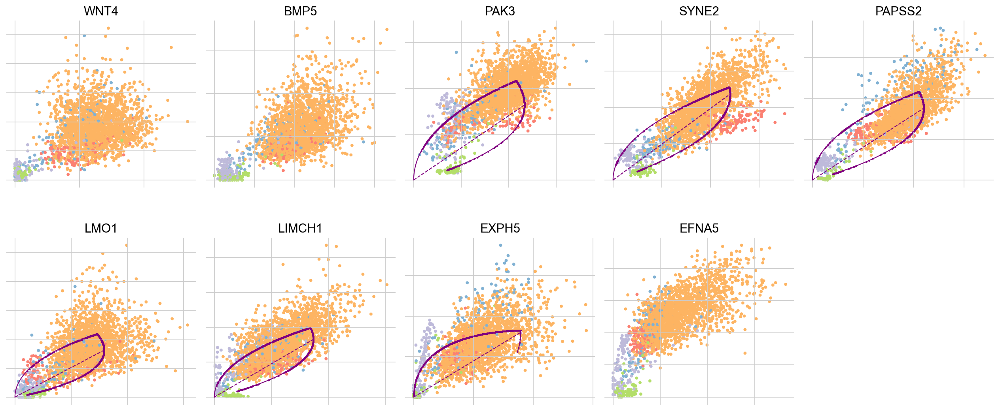

In [201]:
scv.pl.scatter(adata_63_velo_beta, ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], wspace=0.05, frameon=False, ncols=5, color='louvain_anno_fine')

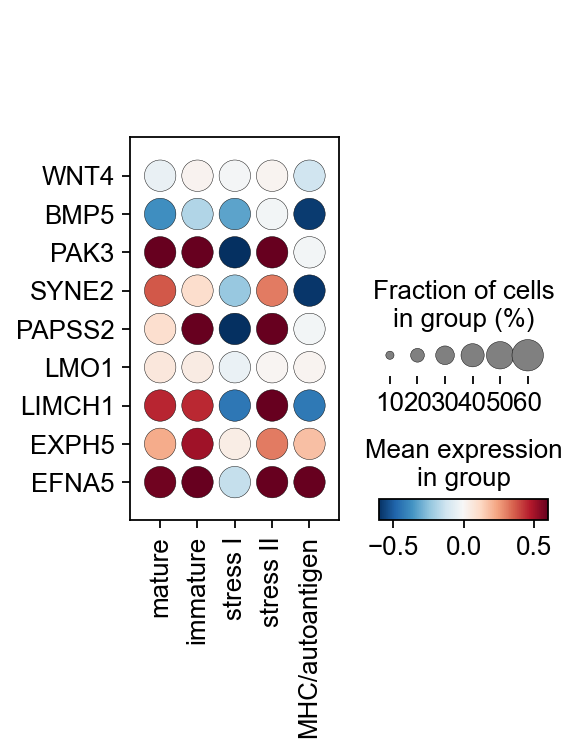

In [354]:
sc.pl.dotplot(adata_63_velo_beta, groupby='louvain_anno_fine', dot_max=0.6, layer='velocity', 
              expression_cutoff=-2,vmin=-0.6, vmax=0.6, cmap='RdBu_r',
              var_names=['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5'], swap_axes=True)

#### mature state - high velocity expression genes

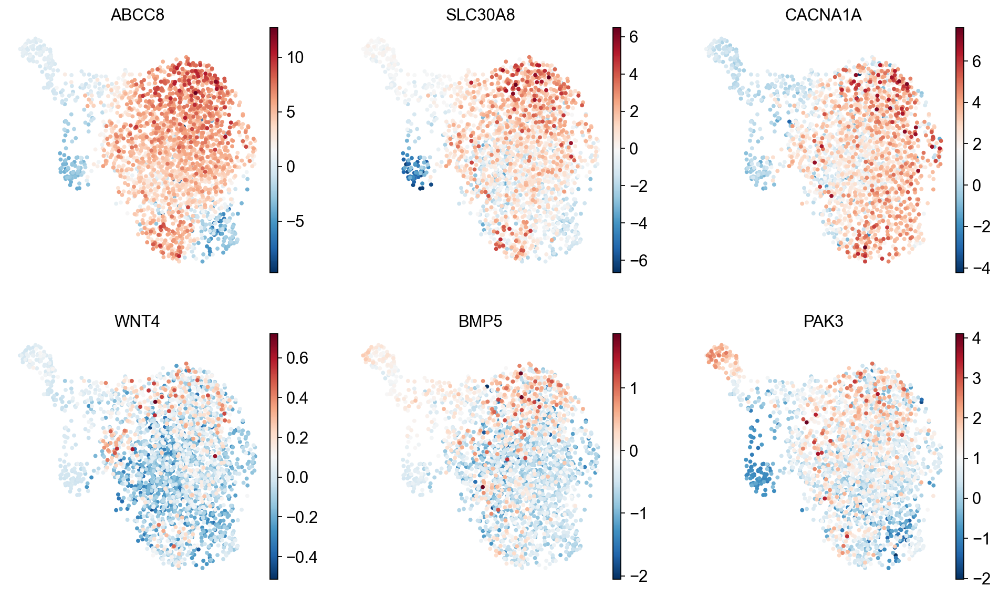

In [204]:
sc.pl.umap(adata_63_velo_beta, layer='velocity', 
           color=['ABCC8', 'SLC30A8', 'CACNA1A', 'WNT4', 'BMP5', 'PAK3'],ncols=3, cmap='RdBu_r')

#### velocity clusters

In [411]:
scv.tl.rank_velocity_genes(adata_63_velo_beta, resolution=0.8)

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [412]:
del adata_63_velo_beta.uns['velocity_clusters_colors']

In [413]:
adata_63_velo_beta.obs['velocity_clusters_str'] = [str(i) for i in adata_63_velo_beta.obs['velocity_clusters']]

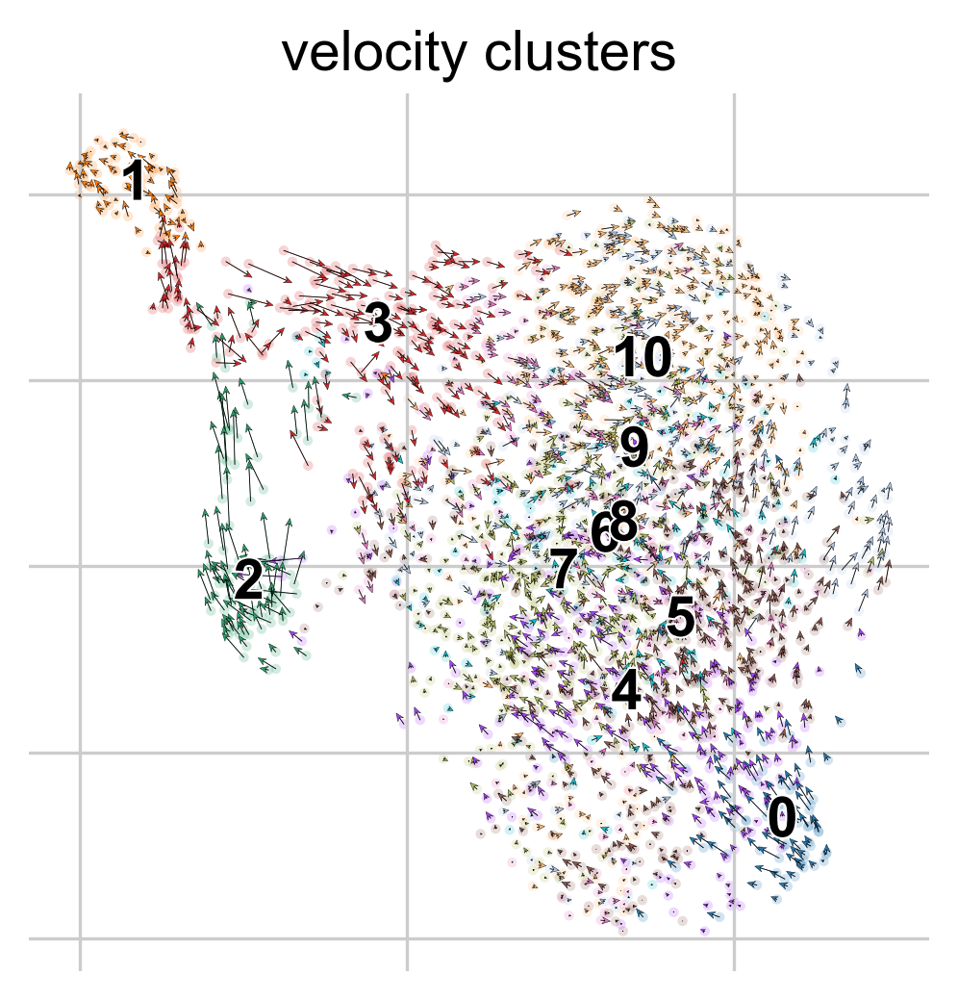

In [414]:
scv.pl.velocity_embedding(adata_63_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='velocity_clusters', legend_loc='on data')

In [432]:
adata_63_proc.obs['velocity_clusters'] = adata_63_velo_beta.obs.velocity_clusters

In [436]:
map_names = {}
for c in adata_63_proc.obs['velocity_clusters'].cat.categories:
    if c in ['9', ]:
        map_names[c] = 'high velocity'
    elif c in ['2', '1', '3', '0']:
        map_names[c] = 'other'
    else:
        map_names[c] = 'low velocity'

adata_63_proc.obs['velocity_clusters_anno']=adata_63_proc.obs['velocity_clusters']
adata_63_proc.obs['velocity_clusters_anno']=adata_63_proc.obs['velocity_clusters_anno'].map(map_names).astype('category')

In [464]:
adata_63_proc.uns['velocity_clusters_anno_colors'] = ['#cc4c02','#fdb462',  '#d9d9d9']

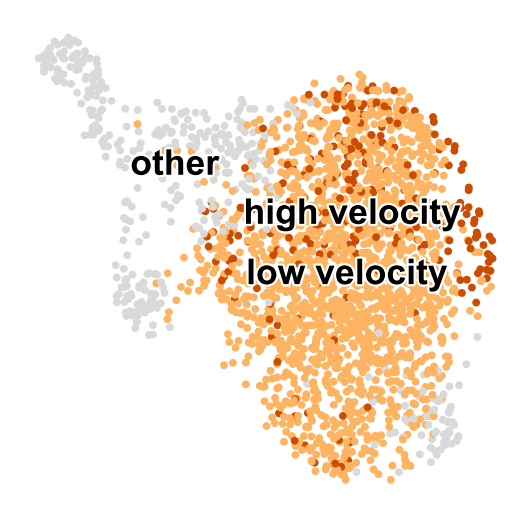

In [465]:
sc.pl.umap(adata_63_proc, color='velocity_clusters_anno', title='', legend_loc='on data', legend_fontoutline=2, legend_fontsize=16)

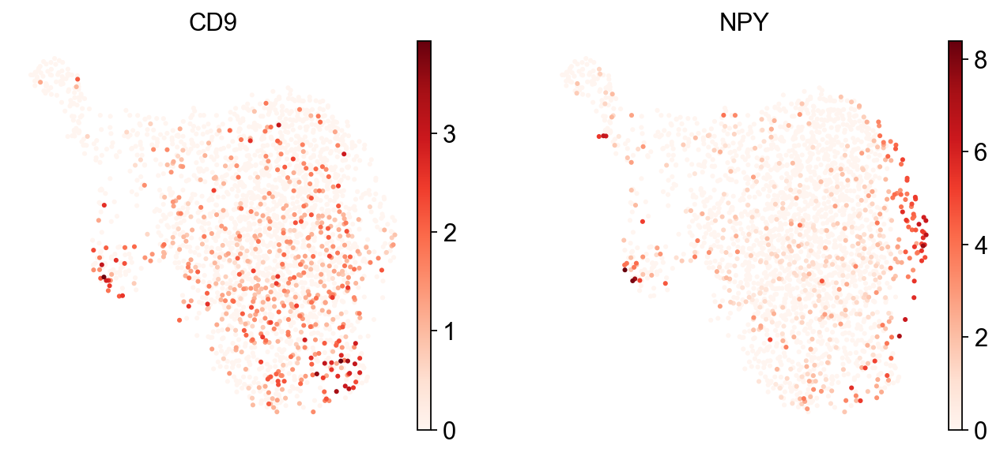

In [383]:
sc.pl.umap(adata_63_proc, color=['CD9', 'NPY'], size=30, color_map='Reds')

In [439]:
dorell_markers = {'CD9+': ['CD9', 'SLC44A4', 'CD74', 'TSPAN33', 'RBP4', 'PTGS2', 
                           'PPP1R1A', 'AK5', 'VWA5B2', 'ZFP36', 'SLC7A14', 'EPB41L1'],
                  'CD9-': ['NPY','FKBP5', 'HDAC9', 'PCDH7', 'SLC8A1', 'SEMA6A', 'LINGO2', 
                           'SIM1', 'TAGLN3', 'ASB9', 'TSPAN1', 'AMPH', 'KCNH7', 'KCNH1', 
                           'ADAMTS5', 'RALYL', 'DGKB', 'KLHL1']}

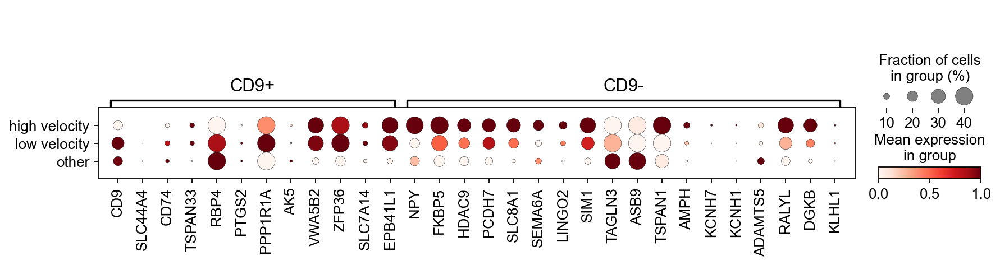

In [440]:
markers_sub = {}
for key in dorell_markers.keys():
    genes = [gene for gene in dorell_markers[key] if gene in adata_63_proc.var_names]
    if len(genes)>0:
        markers_sub[key]=genes
sc.pl.dotplot(adata_63_proc, var_names=markers_sub,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4)

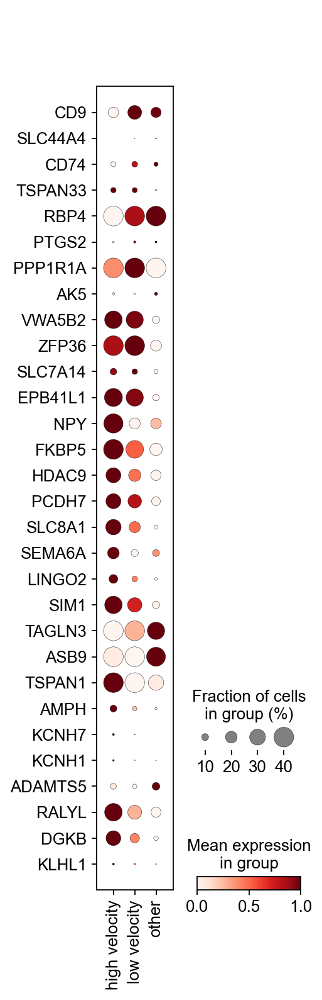

In [441]:
sc.pl.dotplot(adata_63_proc, var_names=dorell_markers_genes,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4, swap_axes=True)

## Beta cell donor 24

This requires to run velocyto to extract information on splices/unspliced reads

In [230]:
adata_beta.obs.donor.value_counts()

74    3827
63    2440
61    2196
22    1975
24    1485
Name: donor, dtype: int64

In [231]:
adata_24_velo_beta = adata_raw[adata_raw.obs['sample']=='24'].copy()

In [232]:
adata_24_velo_beta = adata_24_velo_beta[[ix for ix in adata_beta.obs_names if ix in adata_24_velo_beta.obs_names]].copy()

In [233]:
adata_24_velo_beta

AnnData object with n_obs × n_vars = 1485 × 32738
    obs: 'sample'
    var: 'ensembl_ID'

In [234]:
# load loom file
adata_24_loom = sc.read_loom('./data/velocity/HI_24.loom')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [235]:
adata_24_loom.obs_names

Index(['HI_24:AAACGGGGTCCAGTGCx', 'HI_24:AAATGCCCACGACTCGx',
       'HI_24:AAAGTAGAGTTAAGTGx', 'HI_24:AAACGGGTCATAGCACx',
       'HI_24:AAAGCAACAAAGGAAGx', 'HI_24:AAAGATGTCGGTCTAAx',
       'HI_24:AACACGTCAGGAATCGx', 'HI_24:AAACCTGAGACACGACx',
       'HI_24:AAAGATGAGTTGCAGGx', 'HI_24:AAAGATGCACAGGTTTx',
       ...
       'HI_24:TTTGGTTGTGTTCTTTx', 'HI_24:TTTGCGCGTTGGTAAAx',
       'HI_24:TTTGGTTAGCGATAGCx', 'HI_24:TTTGGTTCATACAGCTx',
       'HI_24:TTTGGTTGTACCCAATx', 'HI_24:TTTGGTTTCCCTAATTx',
       'HI_24:TTTGTCACAGAGTGTGx', 'HI_24:TTTGTCAGTTTGACTGx',
       'HI_24:TTTGGTTCATGTTCCCx', 'HI_24:TTTGGTTAGGGATGGGx'],
      dtype='object', name='CellID', length=7847)

In [236]:
adata_24_velo_beta.obs_names

Index(['AAACCTGAGACAAAGG-24', 'AAACCTGGTACGACCC-24', 'AAACCTGGTTTGCATG-24',
       'AAACGGGGTCCAGTGC-24', 'AAACGGGGTCTCAACA-24', 'AAACGGGTCCGTAGTA-24',
       'AAACGGGTCTGTTTGT-24', 'AAAGATGGTTCTCATT-24', 'AAAGCAAGTCTCTTTA-24',
       'AAAGTAGAGAGTACAT-24',
       ...
       'TTTGCGCCAAGGACTG-24', 'TTTGCGCTCAGCGATT-24', 'TTTGCGCTCGCGCCAA-24',
       'TTTGCGCTCTTGAGGT-24', 'TTTGGTTAGGGATGGG-24', 'TTTGGTTAGGTGGGTT-24',
       'TTTGGTTAGTTGAGAT-24', 'TTTGGTTGTGTTCTTT-24', 'TTTGTCACAGGATTGG-24',
       'TTTGTCAGTTTGACTG-24'],
      dtype='object', length=1485)

In [237]:
# adapt obs_names to match
adata_24_loom.obs_names = [x[6:22] +'-24' for x in adata_24_loom.obs_names]

In [238]:
# filter and sort velocity/loom adata
adata_24_loom = adata_24_loom[[x for x in adata_24_velo_beta.obs_names if x in adata_24_loom.obs_names]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [239]:
adata_24_loom

AnnData object with n_obs × n_vars = 1485 × 32738
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [240]:
adata_24_loom.var_names_make_unique()

In [241]:
adata_24_loom.var_names

Index(['FAM138A', 'RP11-34P13.7', 'RP11-34P13.8', 'AL627309.1',
       'RP11-34P13.14', 'AP006222.2', 'RP4-669L17.2', 'RP5-857K21.1',
       'RP5-857K21.3', 'RP5-857K21.4',
       ...
       'BPY2', 'DAZ2', 'AC016752.1', 'TTTY17B', 'TTTY4B', 'BPY2B', 'DAZ4',
       'CSPG4P1Y', 'CDY1', 'TTTY3'],
      dtype='object', name='Gene', length=32738)

In [242]:
adata_24_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [243]:
adata_24_loom = adata_24_loom[:,[x for x in adata_24_velo_beta.var_names if x in adata_24_loom.var_names]].copy()

In [244]:
# add unspliced/spliced count information to raw data
adata_24_velo_beta.layers['matrix'] = adata_24_loom.layers['matrix']
adata_24_velo_beta.layers['ambiguous'] = adata_24_loom.layers['ambiguous']
adata_24_velo_beta.layers['spliced'] = adata_24_loom.layers['spliced']
adata_24_velo_beta.layers['unspliced'] = adata_24_loom.layers['unspliced']
del adata_24_loom

In [245]:
adata_24_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [248]:
# subset to donor 61 to get meta data
adata_24_proc = adata_beta[np.isin(adata_beta.obs['donor'], ['24'])].copy()

In [249]:
# add metadata
adata_24_velo_beta.obs = adata_24_proc.obs.loc[adata_24_velo_beta.obs_names].copy()

In [250]:
# normalize raw data using exclude_highly_expressed
sc.pp.normalize_total(adata_24_velo_beta, exclude_highly_expressed=True)
sc.pp.log1p(adata_24_velo_beta)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['GCG', 'GHRL', 'SST', 'HSPA5', 'RBP4', 'INS', 'MALAT1', 'IAPP', 'PPY', 'TTR', 'MT-CO1']
    finished (0:00:00)


In [251]:
# exlude mtDNA deficient subtype
adata_24_proc = adata_24_proc[np.invert(adata_24_proc.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [252]:
# compute manifold
sc.pp.pca(adata_24_proc)
sc.pp.neighbors(adata_24_proc)
sc.tl.umap(adata_24_proc)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


In [253]:
len(set(adata_24_proc.obs_names).intersection(adata_24_velo_beta.obs_names))

1472

In [254]:
adata_24_velo_beta = adata_24_velo_beta[np.invert(adata_24_velo_beta.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [255]:
adata_24_velo_beta.obsm['X_umap'] = adata_24_proc.obsm['X_umap']

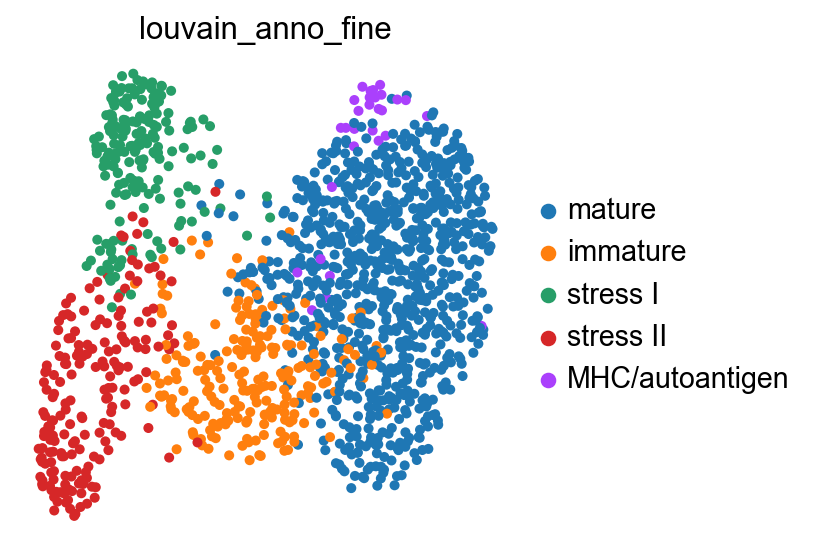

In [256]:
sc.pl.umap(adata_24_velo_beta,color='louvain_anno_fine')

In [257]:
scv.pp.filter_and_normalize(adata_24_velo_beta, min_shared_counts=10, n_top_genes=4000, min_cells_u=10)

Filtered out 18455 genes that are detected in less than 10 cells (unspliced).
Filtered out 5563 genes that are detected 10 counts (shared).
Normalized count data: spliced, unspliced.
Exctracted 4000 highly variable genes.


In [258]:
scv.pp.moments(adata_24_velo_beta)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:00)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [259]:
scv.tl.velocity(adata_24_velo_beta)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [260]:
%%time
scv.tl.recover_dynamics(adata_24_velo_beta)

recovering dynamics
    finished (0:03:20) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
CPU times: user 3min 17s, sys: 1.39 s, total: 3min 18s
Wall time: 3min 20s


In [261]:
top_genes = adata_24_velo_beta.var['fit_likelihood'].sort_values(ascending=False)[adata_24_velo_beta.var['fit_likelihood'].sort_values(ascending=False)>0.1].index
scv.tl.differential_kinetic_test(adata_24_velo_beta, var_names=top_genes, groupby='louvain_anno_fine')

testing for differential kinetics
    finished (0:00:48) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [262]:
len(top_genes)

709

In [263]:
adata_24_velo_beta.uns['louvain_anno_fine_colors'] = adata_beta.uns['louvain_anno_fine_colors'][0:5]

In [264]:
scv.tl.velocity(adata_24_velo_beta, diff_kinetics=False)
scv.tl.velocity_graph(adata_24_velo_beta, gene_subset=top_genes)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


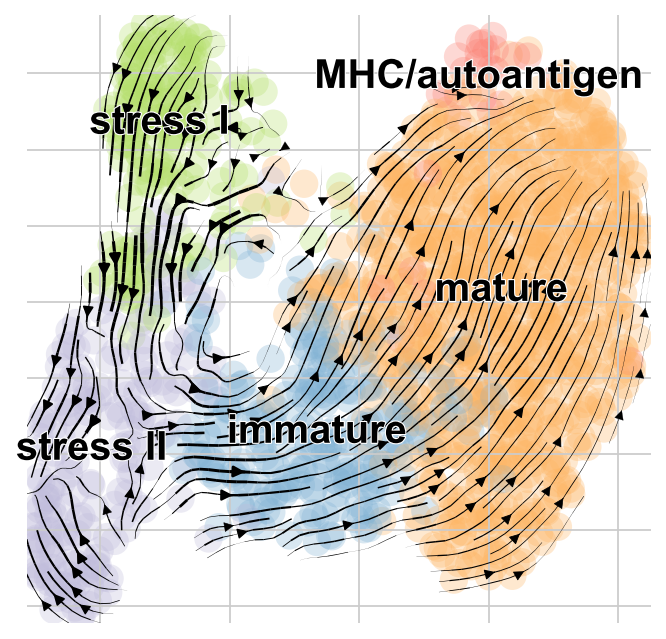

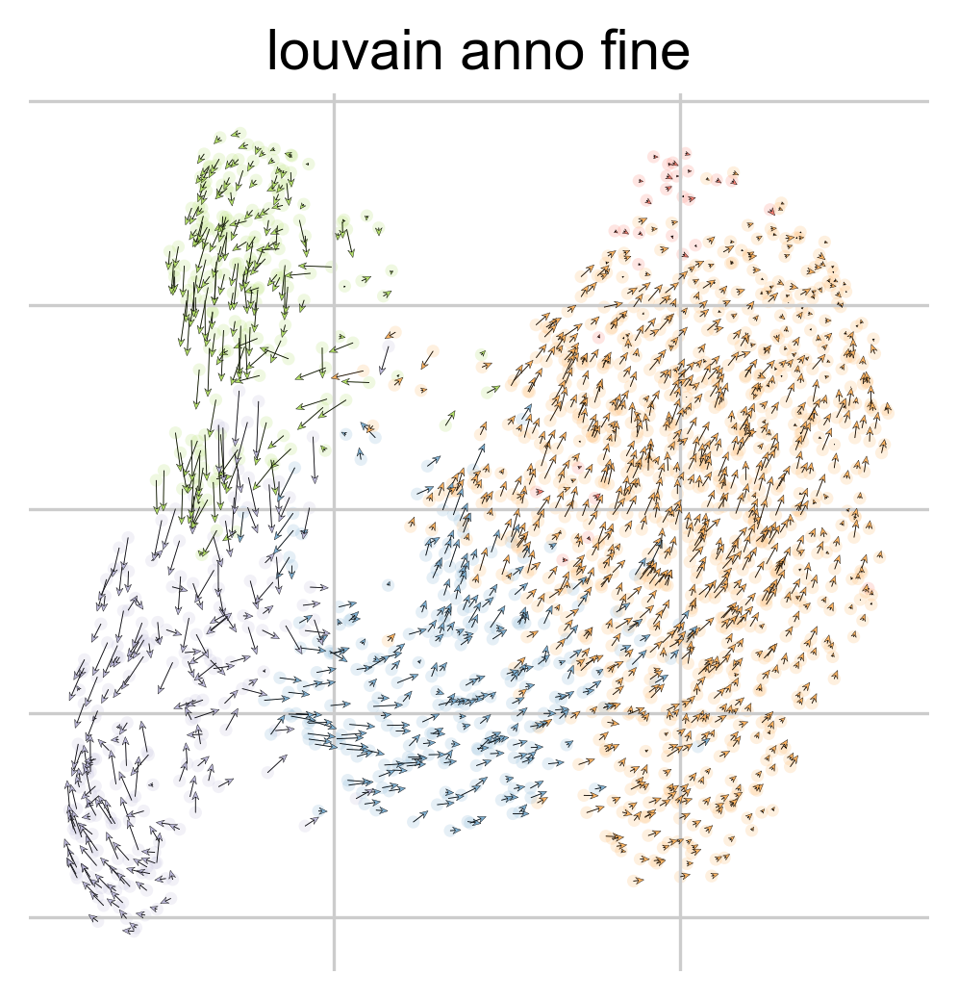

In [265]:
scv.pl.velocity_embedding_stream(adata_24_velo_beta, basis='umap',color='louvain_anno_fine',figsize=(5,5), legend_fontsize=18, title='')
scv.pl.velocity_embedding(adata_24_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='louvain_anno_fine')

#### differential velocyto expression test

In [266]:
scv.tl.rank_velocity_genes(adata_24_velo_beta, groupby='louvain_anno_fine', n_genes=1800, min_likelihood=0.1)
df = scv.DataFrame(adata_24_velo_beta.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,mature,immature,stress I,stress II,MHC/autoantigen
0,METRN,RAB3B,ITGAM,PLEKHH2,ICA1
1,ATRNL1,PAPSS2,NUP210L,NEDD4L,FLRT3
2,RP11-728F11.4,SORL1,DNAH2,HIST1H2AC,TIAM1
3,SCTR,RAP1GAP2,MANF,RP4-553F4.6,KLHDC8A
4,DPP6,ANXA11,PDE4C,HRK,GULP1
5,ABCC8,ATP9A,CFC1,WARS,ZNF385D
6,XPR1,RBM47,HESX1,KCNK1,STXBP6
7,KIRREL3,ZNF618,ABTB2,MAGT1,SYNE4
8,HEPACAM2,SLC29A4,AMPD3,ZBTB43,PAX6
9,GAD2,NEURL1,POU2F2,ABCB1,SLC16A12


##### Supplementary Table 4

In [267]:
velo_mature = adata_24_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_24_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
velo_immature = adata_24_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_24_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()
velo_stress_I = adata_24_velo_beta.uns['rank_velocity_genes']['names']['stress I'][adata_24_velo_beta.uns['rank_velocity_genes']['scores']['stress I']>2].tolist()
velo_stress_II = adata_24_velo_beta.uns['rank_velocity_genes']['names']['stress II'][adata_24_velo_beta.uns['rank_velocity_genes']['scores']['stress II']>2].tolist()

In [268]:
print(f'donor 74: {len(velo_mature_74)}')
print(f'donor 63: {len(velo_mature)}')
print(f'63 & 74: {len(set(velo_mature_74.names).intersection(velo_mature))}')

donor 74: 143
donor 63: 253
63 & 74: 76


In [269]:
print(f'donor 74: {len(velo_immature_74)}')
print(f'donor 63: {len(velo_immature)}')
print(f'63 & 74: {len(set(velo_immature_74.names).intersection(velo_immature))}')

donor 74: 85
donor 63: 86
63 & 74: 27


#### immature state - high velocity expression genes

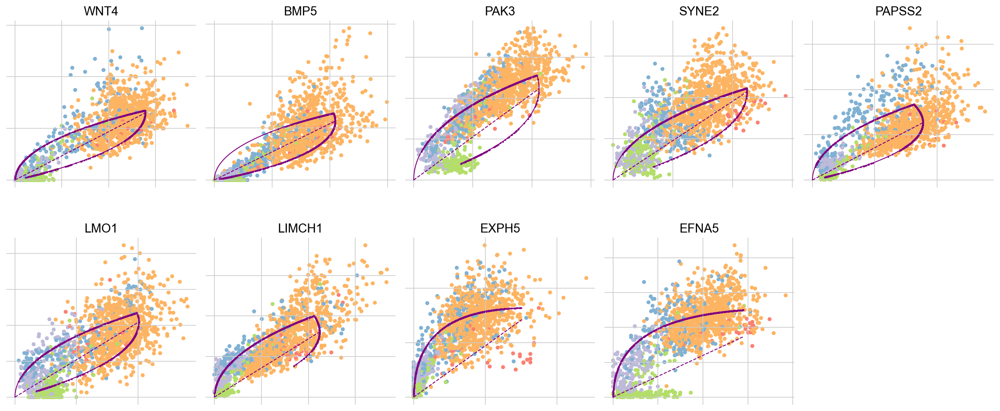

In [270]:
scv.pl.scatter(adata_24_velo_beta, ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], wspace=0.05, frameon=False, ncols=5, color='louvain_anno_fine')

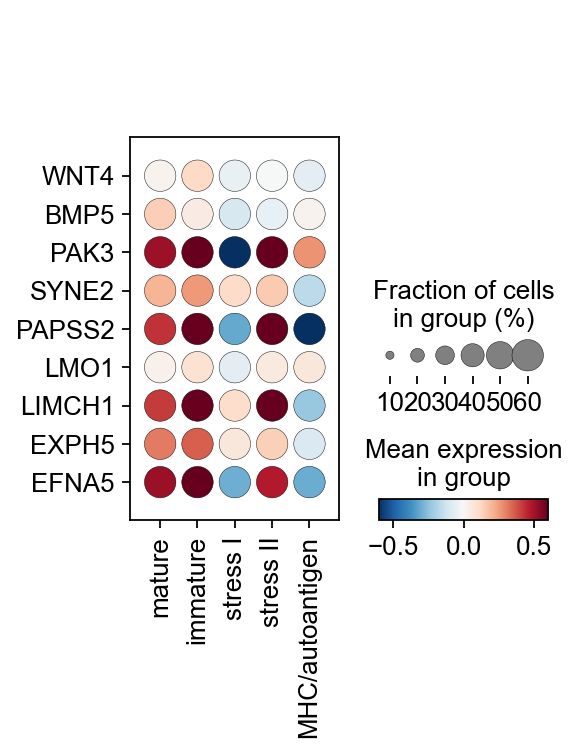

In [355]:
sc.pl.dotplot(adata_24_velo_beta, groupby='louvain_anno_fine', dot_max=0.6, layer='velocity', 
              expression_cutoff=-2,vmin=-0.6, vmax=0.6, cmap='RdBu_r',
              var_names=['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5'], swap_axes=True)

#### mature state - high velocity expression genes

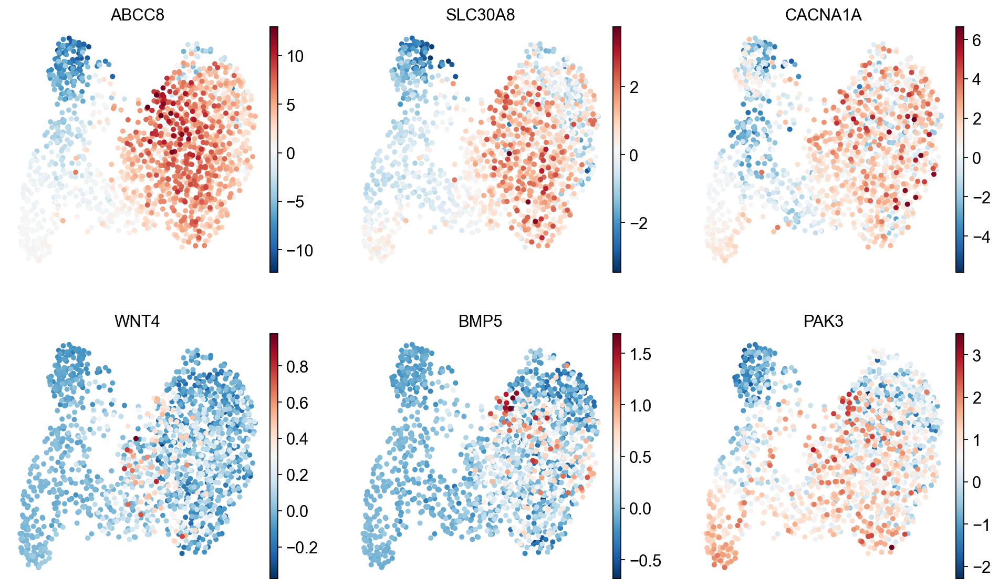

In [273]:
sc.pl.umap(adata_24_velo_beta, layer='velocity', 
           color=['ABCC8', 'SLC30A8', 'CACNA1A', 'WNT4', 'BMP5', 'PAK3'],ncols=3, cmap='RdBu_r')

#### velocity clusters

In [544]:
scv.tl.rank_velocity_genes(adata_24_velo_beta, resolution=0.5)

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [545]:
adata_24_velo_beta.obs['velocity_clusters_str'] = [str(i) for i in adata_24_velo_beta.obs['velocity_clusters']]

In [546]:
del adata_24_velo_beta.uns['velocity_clusters_colors']

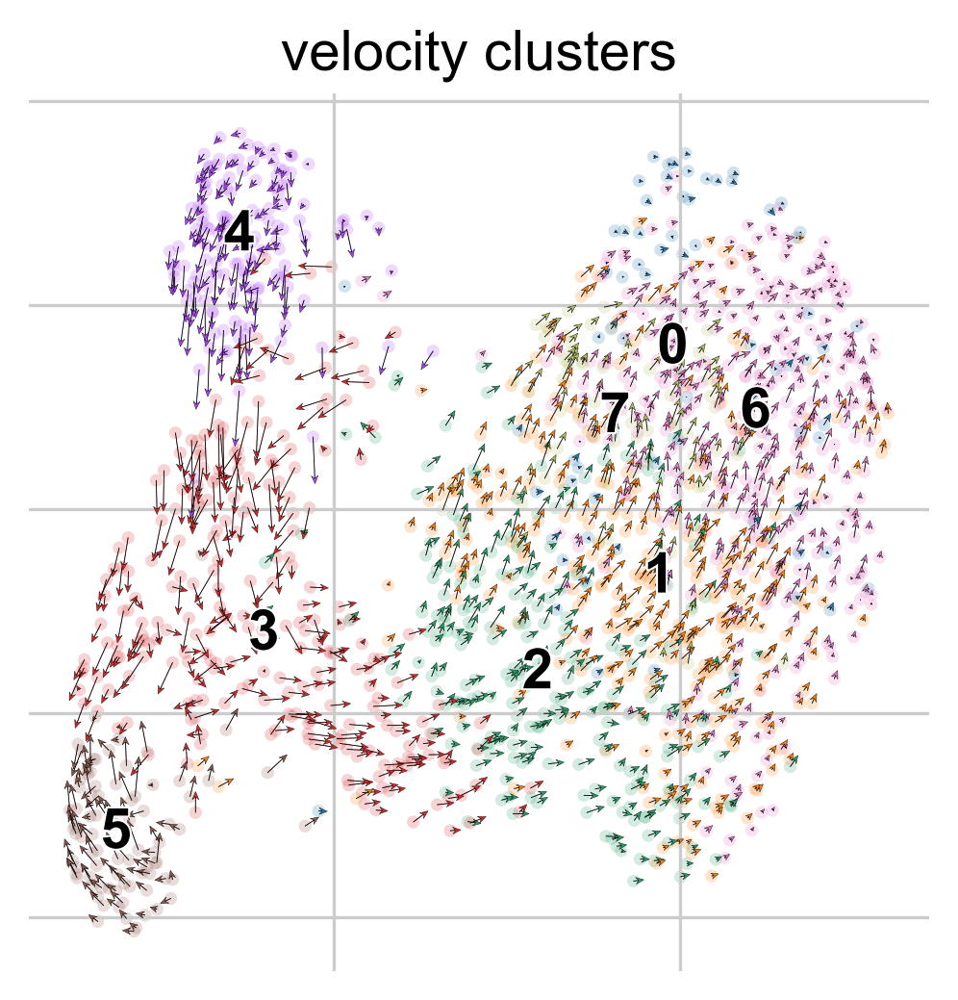

In [547]:
scv.pl.velocity_embedding(adata_24_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150, color='velocity_clusters', legend_loc='on data')

In [548]:
adata_24_proc.obs['velocity_clusters'] = adata_24_velo_beta.obs.velocity_clusters

In [555]:
map_names = {}
for c in adata_24_proc.obs['velocity_clusters'].cat.categories:
    if c in []:
        map_names[c] = 'low velocity'
    elif c in ['1', '2', '7', '6']:
        map_names[c] = 'high velocity'
    else:
        map_names[c] = 'other'

adata_24_proc.obs['velocity_clusters_anno']=adata_24_proc.obs['velocity_clusters']
adata_24_proc.obs['velocity_clusters_anno']=adata_24_proc.obs['velocity_clusters_anno'].map(map_names).astype('category')

In [560]:
adata_24_proc.uns['velocity_clusters_anno_colors'] = ['#cc4c02',  '#d9d9d9']

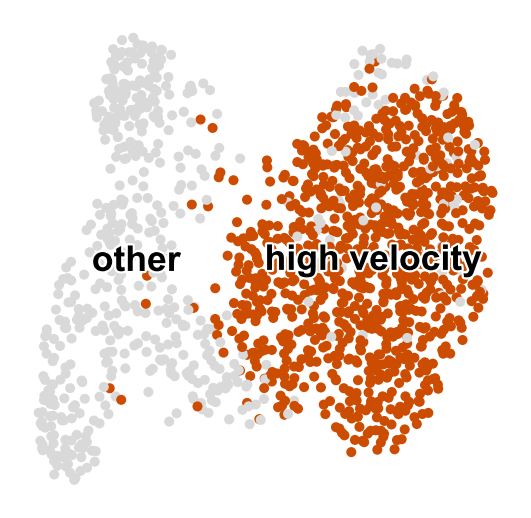

In [565]:
sc.pl.umap(adata_24_proc, color='velocity_clusters_anno', title='', legend_loc='on data', legend_fontoutline=2, legend_fontsize=16)

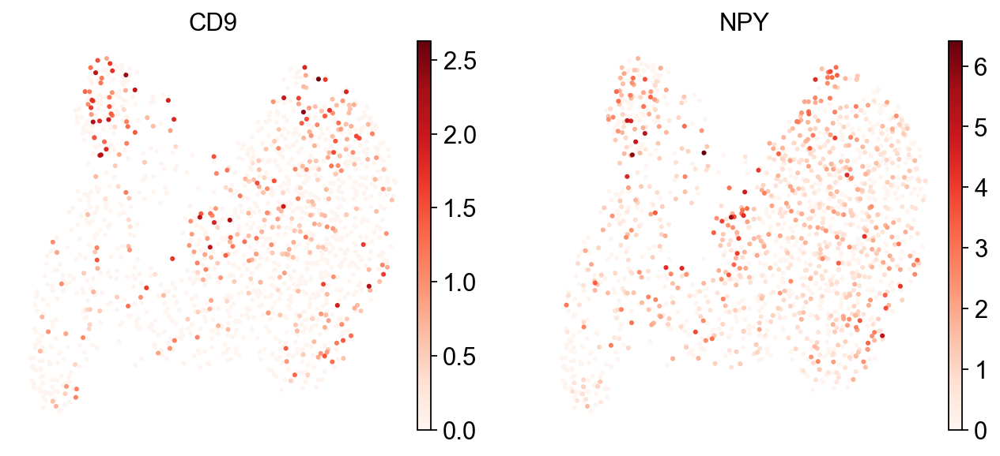

In [562]:
sc.pl.umap(adata_24_proc, color=['CD9', 'NPY'], size=30, color_map='Reds')

In [563]:
dorell_markers = {'CD9+': ['CD9', 'SLC44A4', 'CD74', 'TSPAN33', 'RBP4', 'PTGS2', 
                           'PPP1R1A', 'AK5', 'VWA5B2', 'ZFP36', 'SLC7A14', 'EPB41L1'],
                  'CD9-': ['NPY','FKBP5', 'HDAC9', 'PCDH7', 'SLC8A1', 'SEMA6A', 'LINGO2', 
                           'SIM1', 'TAGLN3', 'ASB9', 'TSPAN1', 'AMPH', 'KCNH7', 'KCNH1', 
                           'ADAMTS5', 'RALYL', 'DGKB', 'KLHL1']}

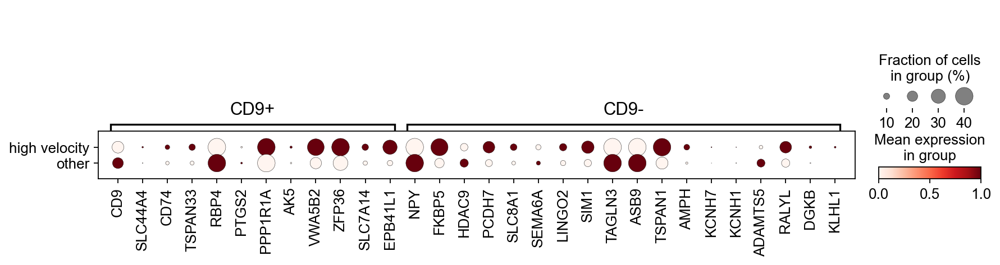

In [564]:
markers_sub = {}
for key in dorell_markers.keys():
    genes = [gene for gene in dorell_markers[key] if gene in adata_24_proc.var_names]
    if len(genes)>0:
        markers_sub[key]=genes
sc.pl.dotplot(adata_24_proc, var_names=markers_sub,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4)

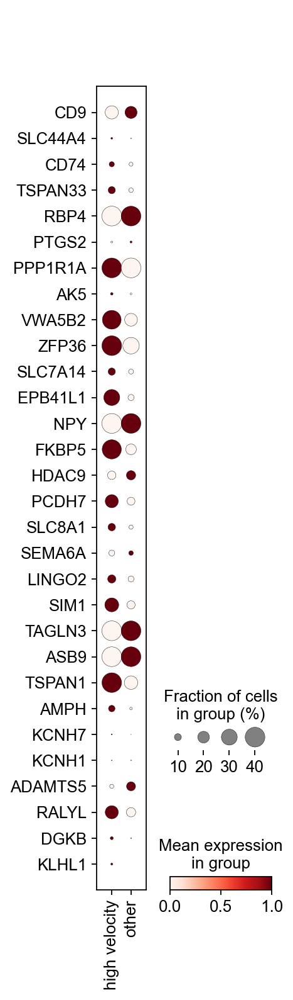

In [566]:
sc.pl.dotplot(adata_24_proc, var_names=dorell_markers_genes,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4, swap_axes=True)

## Beta cell donor 22

This requires to run velocyto to extract information on splices/unspliced reads

In [284]:
adata_beta.obs.donor.value_counts()

74    3827
63    2440
61    2196
22    1975
24    1485
Name: donor, dtype: int64

In [285]:
adata_22_velo_beta = adata_raw[adata_raw.obs['sample']=='22'].copy()

In [286]:
adata_22_velo_beta = adata_22_velo_beta[[ix for ix in adata_beta.obs_names if ix in adata_22_velo_beta.obs_names]].copy()

In [287]:
adata_22_velo_beta

AnnData object with n_obs × n_vars = 1975 × 32738
    obs: 'sample'
    var: 'ensembl_ID'

In [299]:
# load loom file
adata_22_loom = sc.read_loom('./data/velocity/Human_Islet.loom')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [300]:
adata_22_loom.obs_names

Index(['Human_Islet:AACACGTGTTAGGGTGx', 'Human_Islet:AAATGCCCATATACCGx',
       'Human_Islet:AAAGCAAAGTGCGTGAx', 'Human_Islet:AAATGCCAGCCGATTTx',
       'Human_Islet:AAAGATGGTCCAACTAx', 'Human_Islet:AAACCTGTCTTCATGTx',
       'Human_Islet:AAATGCCCATCGACGCx', 'Human_Islet:AAACCTGTCGTCGTTCx',
       'Human_Islet:AAAGCAATCTACTATCx', 'Human_Islet:AAATGCCAGAAGCCCAx',
       ...
       'Human_Islet:TTTGTCACAATGAATGx', 'Human_Islet:TTTGTCATCTATCCTAx',
       'Human_Islet:TTTGTCACACCAGGCTx', 'Human_Islet:TTTGTCACAGGTGGATx',
       'Human_Islet:TTTGTCATCTGTGCAAx', 'Human_Islet:TTTGTCATCCTCTAGCx',
       'Human_Islet:TTTGTCAGTGCCTGCAx', 'Human_Islet:TTTGTCATCATGCAACx',
       'Human_Islet:TTTGTCAGTGAAGGCTx', 'Human_Islet:TTTGTCAGTCGCATATx'],
      dtype='object', name='CellID', length=7010)

In [301]:
adata_22_velo_beta.obs_names

Index(['AAACCTGGTATTCGTG-22', 'AAACCTGTCGTCGTTC-22', 'AAACCTGTCTCCAGGG-22',
       'AAACGGGCAGCCTTGG-22', 'AAACGGGCAGCTGCAC-22', 'AAACGGGGTATTCTCT-22',
       'AAAGATGAGAATCTCC-22', 'AAAGATGCAACACGCC-22', 'AAAGATGGTCCAACTA-22',
       'AAAGATGTCACGATGT-22',
       ...
       'TTTGCGCTCTTATCTG-22', 'TTTGGTTCACTGAAGG-22', 'TTTGGTTGTCATCGGC-22',
       'TTTGGTTGTCGAGTTT-22', 'TTTGGTTTCCAAAGTC-22', 'TTTGTCAAGATATGCA-22',
       'TTTGTCAAGTAGATGT-22', 'TTTGTCACAAGTTGTC-22', 'TTTGTCACAATGAATG-22',
       'TTTGTCATCTGTGCAA-22'],
      dtype='object', length=1975)

In [308]:
# adapt obs_names to match
adata_22_loom.obs_names = [x[12:28] +'-22' for x in adata_22_loom.obs_names]

In [309]:
# filter and sort velocity/loom adata
adata_22_loom = adata_22_loom[[x for x in adata_22_velo_beta.obs_names if x in adata_22_loom.obs_names]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [310]:
adata_22_loom

AnnData object with n_obs × n_vars = 1975 × 32738
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [311]:
adata_22_loom.var_names_make_unique()

In [312]:
adata_22_loom.var_names

Index(['FAM138A', 'RP11-34P13.7', 'RP11-34P13.8', 'AL627309.1',
       'RP11-34P13.14', 'AP006222.2', 'RP4-669L17.2', 'RP5-857K21.1',
       'RP5-857K21.3', 'RP5-857K21.4',
       ...
       'BPY2', 'DAZ2', 'AC016752.1', 'TTTY17B', 'TTTY4B', 'BPY2B', 'DAZ4',
       'CSPG4P1Y', 'CDY1', 'TTTY3'],
      dtype='object', name='Gene', length=32738)

In [313]:
adata_22_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [314]:
adata_22_loom = adata_22_loom[:,[x for x in adata_22_velo_beta.var_names if x in adata_22_loom.var_names]].copy()

In [315]:
# add unspliced/spliced count information to raw data
adata_22_velo_beta.layers['matrix'] = adata_22_loom.layers['matrix']
adata_22_velo_beta.layers['ambiguous'] = adata_22_loom.layers['ambiguous']
adata_22_velo_beta.layers['spliced'] = adata_22_loom.layers['spliced']
adata_22_velo_beta.layers['unspliced'] = adata_22_loom.layers['unspliced']
del adata_22_loom

In [316]:
adata_22_velo_beta.var_names

Index(['MIR1302-10', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'AL627309.1', 'RP11-34P13.14', 'RP11-34P13.9', 'AP006222.2',
       'RP4-669L17.10',
       ...
       'KIR3DL2-1', 'AL590523.1', 'CT476828.1', 'PNRC2-1', 'SRSF10-1',
       'AC145205.1', 'BAGE5', 'CU459201.1', 'AC002321.2', 'AC002321.1'],
      dtype='object', length=32738)

In [317]:
# subset to donor 62 to get meta data
adata_22_proc = adata_beta[np.isin(adata_beta.obs['donor'], ['22'])].copy()

In [318]:
# add metadata
adata_22_velo_beta.obs = adata_22_proc.obs.loc[adata_22_velo_beta.obs_names].copy()

In [319]:
# normalize raw data using exclude_highly_expressed
sc.pp.normalize_total(adata_22_velo_beta, exclude_highly_expressed=True)
sc.pp.log1p(adata_22_velo_beta)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['GCG', 'GHRL', 'SST', 'INS', 'FTH1', 'MALAT1', 'IAPP', 'FTL']
    finished (0:00:00)


In [320]:
# exlude mtDNA deficient subtype
adata_22_proc = adata_22_proc[np.invert(adata_22_proc.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [321]:
# compute manifold
sc.pp.pca(adata_22_proc)
sc.pp.neighbors(adata_22_proc)
sc.tl.umap(adata_22_proc)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [322]:
len(set(adata_22_proc.obs_names).intersection(adata_22_velo_beta.obs_names))

1969

In [323]:
adata_22_velo_beta = adata_22_velo_beta[np.invert(adata_22_velo_beta.obs.louvain_anno_fine.isin(['mtDNA deficient']))].copy()

In [324]:
adata_22_velo_beta.obsm['X_umap'] = adata_22_proc.obsm['X_umap']

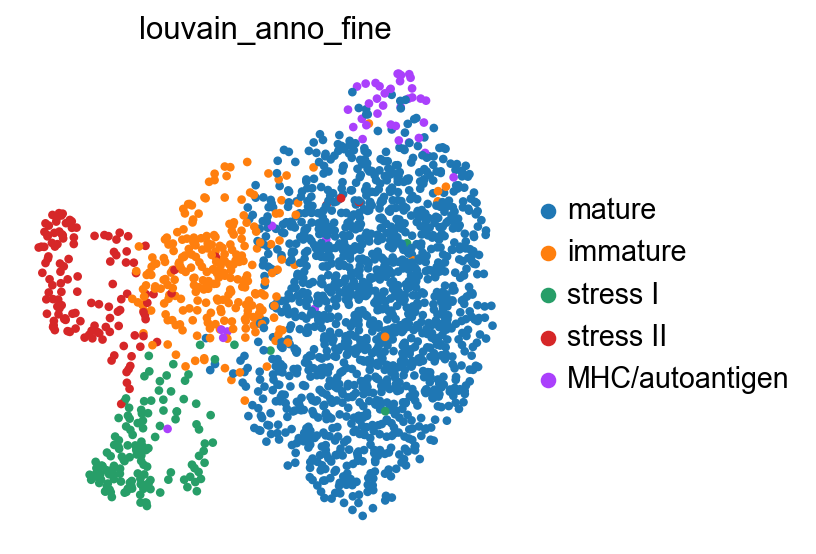

In [325]:
sc.pl.umap(adata_22_velo_beta,color='louvain_anno_fine')

In [326]:
scv.pp.filter_and_normalize(adata_22_velo_beta, min_shared_counts=10, n_top_genes=4000, min_cells_u=10)

Filtered out 17683 genes that are detected in less than 10 cells (unspliced).
Filtered out 5699 genes that are detected 10 counts (shared).
Normalized count data: spliced, unspliced.
Exctracted 4000 highly variable genes.


In [327]:
scv.pp.moments(adata_22_velo_beta)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:00)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [328]:
scv.tl.velocity(adata_22_velo_beta)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [329]:
%%time
scv.tl.recover_dynamics(adata_22_velo_beta)

recovering dynamics
    finished (0:03:14) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
CPU times: user 3min 11s, sys: 966 ms, total: 3min 12s
Wall time: 3min 14s


In [330]:
top_genes = adata_22_velo_beta.var['fit_likelihood'].sort_values(ascending=False)[adata_22_velo_beta.var['fit_likelihood'].sort_values(ascending=False)>0.1].index
scv.tl.differential_kinetic_test(adata_22_velo_beta, var_names=top_genes, groupby='louvain_anno_fine')

testing for differential kinetics
    finished (0:00:35) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [331]:
len(top_genes)

478

In [332]:
adata_22_velo_beta.uns['louvain_anno_fine_colors'] = adata_beta.uns['louvain_anno_fine_colors'][0:5]

In [333]:
scv.tl.velocity(adata_22_velo_beta, diff_kinetics=False)
scv.tl.velocity_graph(adata_22_velo_beta, gene_subset=top_genes)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


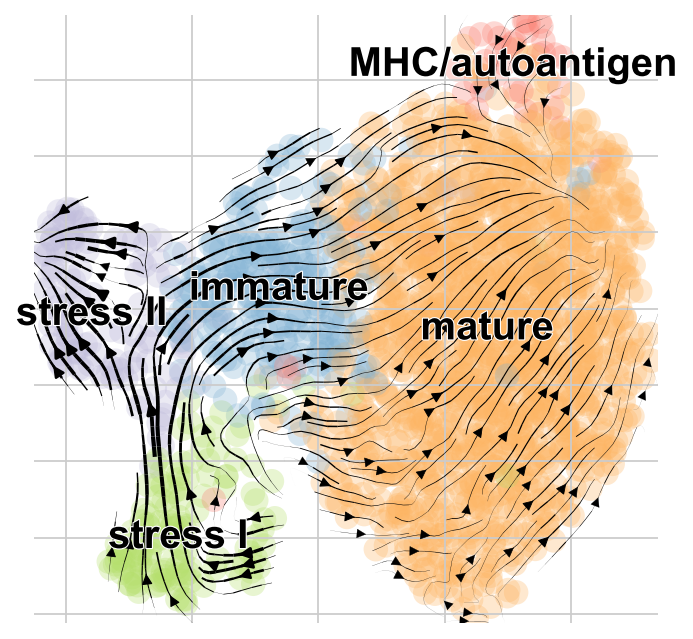

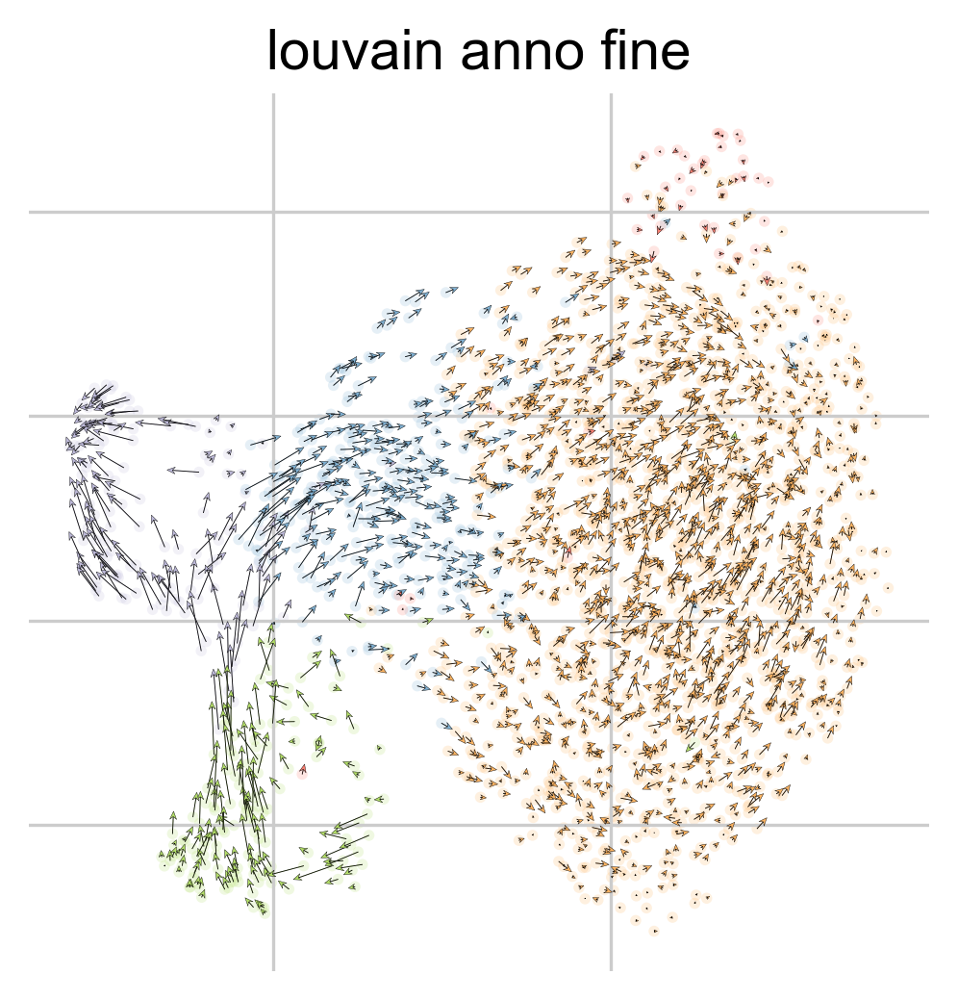

In [334]:
scv.pl.velocity_embedding_stream(adata_22_velo_beta, basis='umap',color='louvain_anno_fine',figsize=(5,5), legend_fontsize=18, title='')
scv.pl.velocity_embedding(adata_22_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='louvain_anno_fine')

#### differential velocyto expression test

In [335]:
scv.tl.rank_velocity_genes(adata_22_velo_beta, groupby='louvain_anno_fine', n_genes=1800, min_likelihood=0.1)
df = scv.DataFrame(adata_22_velo_beta.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:02) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,mature,immature,stress I,stress II,MHC/autoantigen
0,ABCC8,PAPSS2,ACLY,RP11-37N22.1,ZNF385D
1,ROBO2,SORL1,HCG25,HRK,CMIP
2,FAM155A,MAPK6,SYNPO2,PAWR,ICA1L
3,RPS3,WNT4,TRIB3,RP11-3L8.3,EPAS1
4,RPS3A,TTC3,MT1E,CCDC18,NOL4
5,GAD2,GPR56,GNL3,ANXA2,ABLIM1
6,C1orf127,RAP1GAP2,SEL1L,TTC37,TBC1D22A
7,SYT16,RP11-452F19.3,RPL3L,VCP,LRRTM4
8,RPS27,CAMK2B,CFC1,DNAJB9,SGMS2
9,NAV2,SPDYA,CST3,TTC3,PAX6


##### Supplementary Table 4

In [336]:
velo_mature = adata_22_velo_beta.uns['rank_velocity_genes']['names']['mature'][adata_22_velo_beta.uns['rank_velocity_genes']['scores']['mature']>2].tolist()
velo_immature = adata_22_velo_beta.uns['rank_velocity_genes']['names']['immature'][adata_22_velo_beta.uns['rank_velocity_genes']['scores']['immature']>2].tolist()
velo_stress_I = adata_22_velo_beta.uns['rank_velocity_genes']['names']['stress I'][adata_22_velo_beta.uns['rank_velocity_genes']['scores']['stress I']>2].tolist()
velo_stress_II = adata_22_velo_beta.uns['rank_velocity_genes']['names']['stress II'][adata_22_velo_beta.uns['rank_velocity_genes']['scores']['stress II']>2].tolist()

In [337]:
print(f'donor 74: {len(velo_mature_74)}')
print(f'donor 63: {len(velo_mature)}')
print(f'63 & 74: {len(set(velo_mature_74.names).intersection(velo_mature))}')

donor 74: 143
donor 63: 200
63 & 74: 59


In [338]:
print(f'donor 74: {len(velo_immature_74)}')
print(f'donor 63: {len(velo_immature)}')
print(f'63 & 74: {len(set(velo_immature_74.names).intersection(velo_immature))}')

donor 74: 85
donor 63: 95
63 & 74: 20


#### immature state - high velocity expression genes

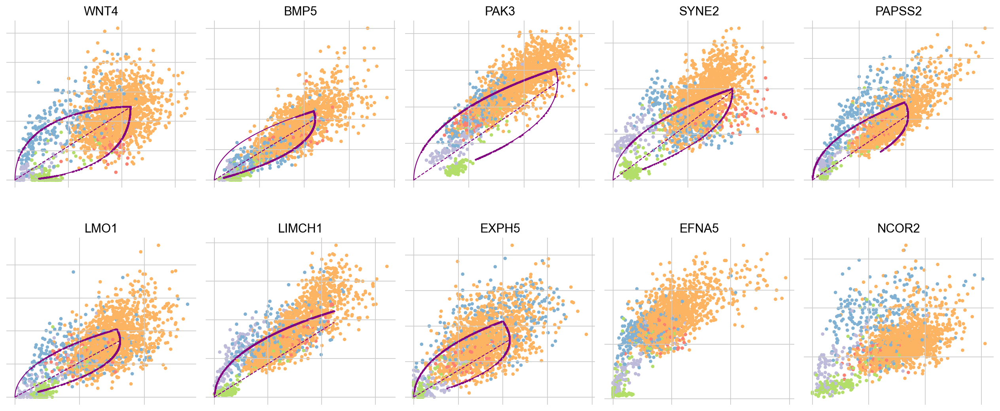

In [339]:
scv.pl.scatter(adata_22_velo_beta, ['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], wspace=0.05, frameon=False, ncols=5, color='louvain_anno_fine')

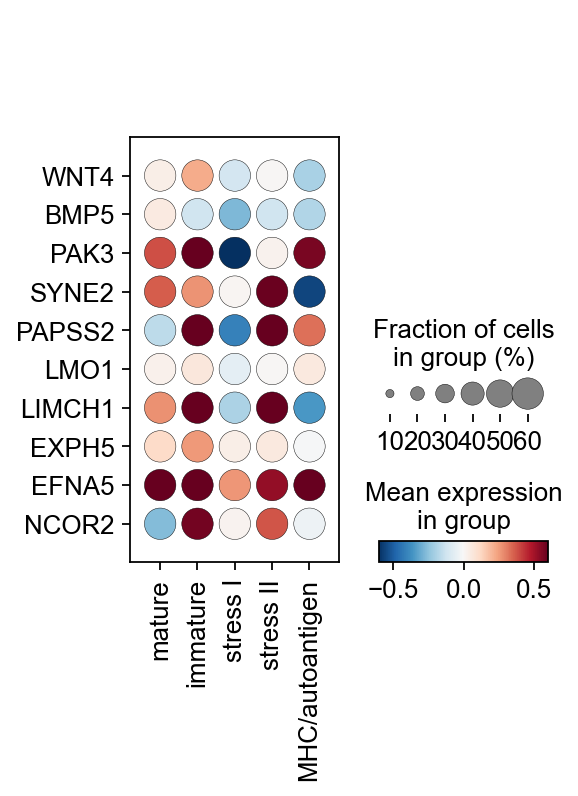

In [356]:
sc.pl.dotplot(adata_22_velo_beta, groupby='louvain_anno_fine', dot_max=0.6, layer='velocity', 
              expression_cutoff=-2,vmin=-0.6, vmax=0.6, cmap='RdBu_r',
              var_names=['WNT4', 'BMP5', 'PAK3', 'SYNE2', 'PAPSS2', 'LMO1',  'LIMCH1', 'EXPH5', 'EFNA5', 'NCOR2'], swap_axes=True)

#### mature state - high velocity expression genes

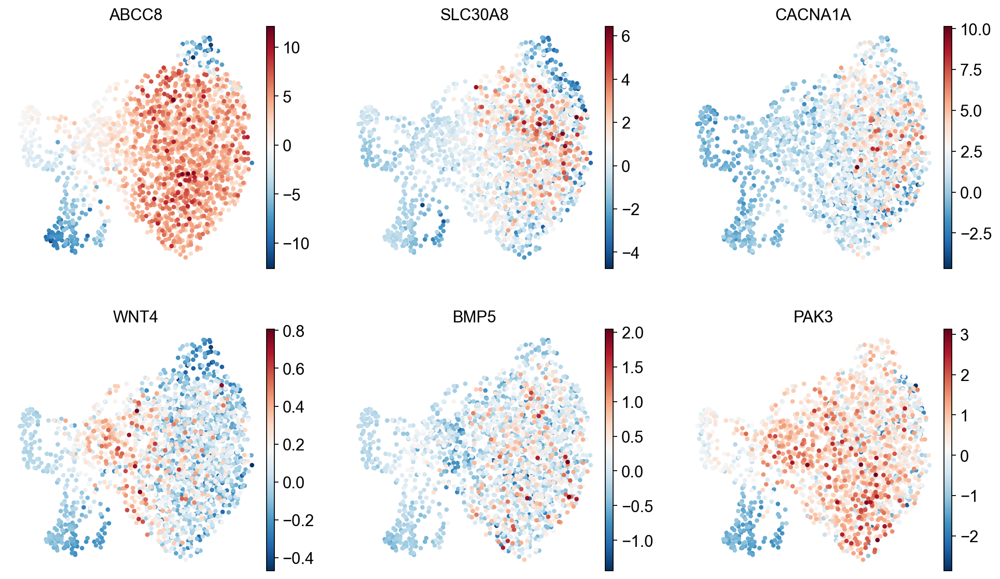

In [341]:
sc.pl.umap(adata_22_velo_beta, layer='velocity', 
           color=['ABCC8', 'SLC30A8', 'CACNA1A', 'WNT4', 'BMP5', 'PAK3'],ncols=3, cmap='RdBu_r')

#### velocity clusters

In [342]:
scv.tl.rank_velocity_genes(adata_22_velo_beta, resolution=0.3)

computing velocity clusters
computing terminal states
    identified 2 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [343]:
adata_22_velo_beta.obs['velocity_clusters_str'] = [str(i) for i in adata_22_velo_beta.obs['velocity_clusters']]

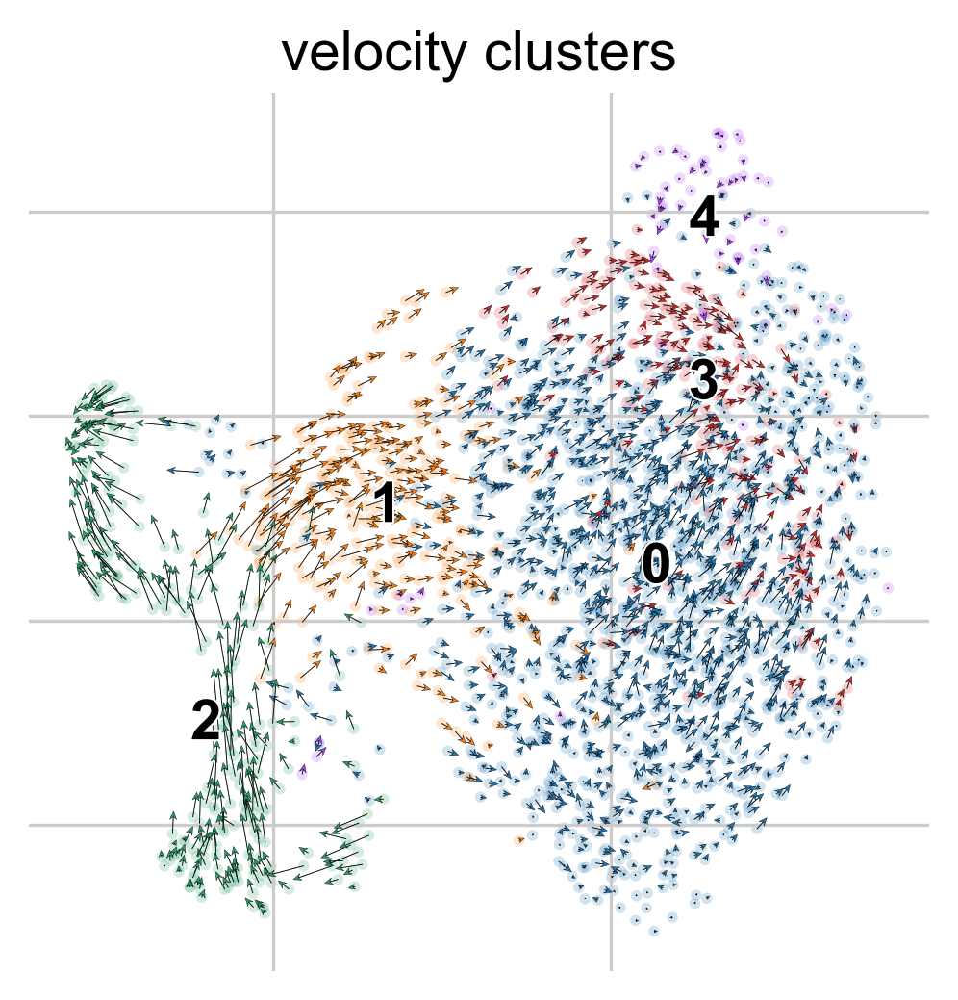

In [344]:
scv.pl.velocity_embedding(adata_22_velo_beta, basis='umap', arrow_length=2, arrow_size=1.5, dpi=150,color='velocity_clusters', legend_loc='on data')

In [358]:
adata_22_proc.obs['velocity_clusters'] = adata_22_velo_beta.obs.velocity_clusters

In [362]:
map_names = {}
for c in adata_22_proc.obs['velocity_clusters'].cat.categories:
    if c in ['0']:
        map_names[c] = 'low velocity'
    elif c in ['3']:
        map_names[c] = 'high velocity'
    else:
        map_names[c] = 'other'

adata_22_proc.obs['velocity_clusters_anno']=adata_22_proc.obs['velocity_clusters']
adata_22_proc.obs['velocity_clusters_anno']=adata_22_proc.obs['velocity_clusters_anno'].map(map_names).astype('category')

In [567]:
adata_22_proc.uns['velocity_clusters_anno_colors'] = ['#cc4c02', '#fdb462', '#d9d9d9']

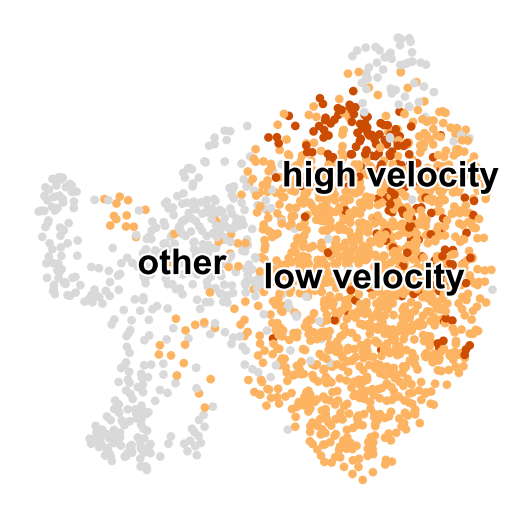

In [568]:
sc.pl.umap(adata_22_proc, color='velocity_clusters_anno', title='', legend_loc='on data', legend_fontoutline=2, legend_fontsize=16)

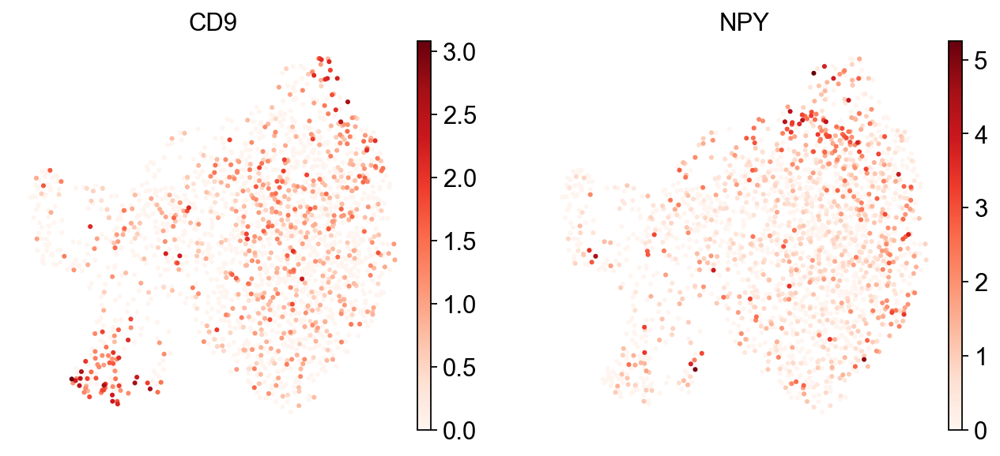

In [365]:
sc.pl.umap(adata_22_proc, color=['CD9', 'NPY'], size=30, color_map='Reds')

In [366]:
dorell_markers = {'CD9+': ['CD9', 'SLC44A4', 'CD74', 'TSPAN33', 'RBP4', 'PTGS2', 
                           'PPP1R1A', 'AK5', 'VWA5B2', 'ZFP36', 'SLC7A14', 'EPB41L1'],
                  'CD9-': ['NPY','FKBP5', 'HDAC9', 'PCDH7', 'SLC8A1', 'SEMA6A', 'LINGO2', 
                           'SIM1', 'TAGLN3', 'ASB9', 'TSPAN1', 'AMPH', 'KCNH7', 'KCNH1', 
                           'ADAMTS5', 'RALYL', 'DGKB', 'KLHL1']}

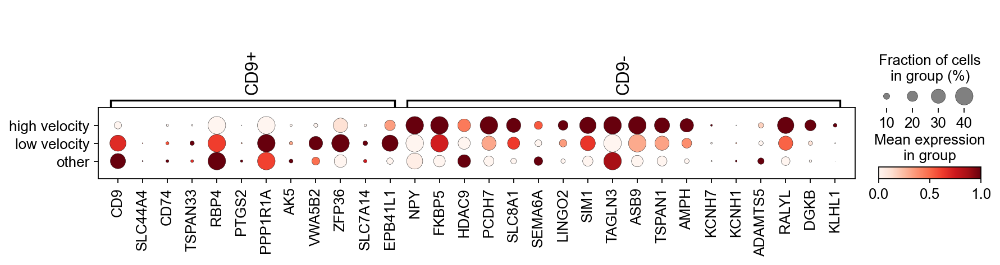

In [570]:
markers_sub = {}
for key in dorell_markers.keys():
    genes = [gene for gene in dorell_markers[key] if gene in adata_22_proc.var_names]
    if len(genes)>0:
        markers_sub[key]=genes
sc.pl.dotplot(adata_22_proc, var_names=markers_sub, var_group_rotation=90,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4)

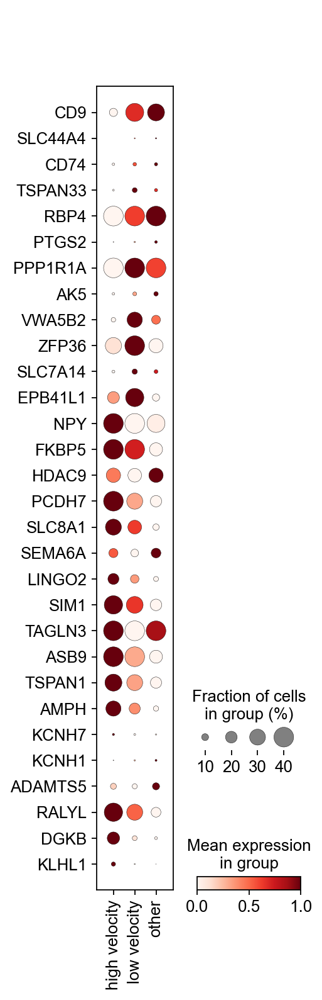

In [569]:
sc.pl.dotplot(adata_22_proc, var_names=dorell_markers_genes,
              groupby='velocity_clusters_anno', standard_scale='var', dot_max=0.4, swap_axes=True)